# Assignment


You have already picked out the dataset you want to work with. 

----

# Question 
1. EDA, i want to see some insights, present it neatly. 
2. Make the best presentation possible.
3. Fit a Decision Tree Classifier.
4. I want to see your trainning accuracy, testing accuracy and your confusion matrix. 
5. That's all, nothing more ^_^

Best of luck !!

![](https://media.tenor.com/fNpgCzeyhwgAAAAC/best-of-luck-good-luck.gif)

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly import __version__
import plotly.express as px
import cufflinks as cf
cf.go_offline()
init_notebook_mode(connected=True)
import plotly.graph_objects as go
from sklearn.metrics import accuracy_score
import statsmodels.api as sm
from sklearn.metrics import confusion_matrix
import random
from sklearn.tree import DecisionTreeClassifier
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn import tree
from sklearn.metrics import r2_score,mean_squared_error
from sklearn.linear_model import LinearRegression
import math
from wordcloud import WordCloud
from sklearn.metrics import confusion_matrix

In [127]:
#from ing_theme_matplotlib import mpl_style
from qbstyles import mpl_style
mpl_style(dark=True)

In [3]:
# Below is a list of palletes stored in a variable palette_values. It will be used to visualize the plots we will be plotting below 
palette_values = ['Accent', 'Accent_r', 'Blues', 'Blues_r', 'BrBG', 'BrBG_r', 'BuGn', 'BuGn_r', 'BuPu', 'BuPu_r', 
 'CMRmap', 'CMRmap_r', 'Dark2', 'Dark2_r', 'GnBu', 'GnBu_r', 'Greens', 'Greens_r', 'Greys', 'Greys_r', 'OrRd', 
 'OrRd_r', 'Oranges', 'Oranges_r', 'PRGn', 'PRGn_r', 'Paired', 'Paired_r', 'Pastel1', 
 'Pastel1_r', 'Pastel2', 'Pastel2_r', 'PiYG', 'PiYG_r', 'PuBu', 'PuBuGn', 'PuBuGn_r', 
 'PuBu_r', 'PuOr', 'PuOr_r', 'PuRd', 'PuRd_r', 'Purples', 'Purples_r', 'RdBu', 'RdBu_r',
'RdGy', 'RdGy_r', 'RdPu', 'RdPu_r', 'RdYlBu', 'RdYlBu_r', 'RdYlGn', 'RdYlGn_r', 'Reds', 
 'Reds_r', 'Set1', 'Set1_r', 'Set2', 'Set2_r', 'Set3', 'Set3_r', 'Spectral', 'Spectral_r', 
 'Wistia','Wistia_r','YlGn', 'YlGnBu', 'YlGnBu_r', 'YlGn_r', 'YlOrBr', 'YlOrBr_r', 'YlOrRd', 
 'YlOrRd_r', 'afmhot', 'afmhot_r', 'autumn', 'autumn_r', 'binary', 'binary_r', 'bone', 
 'bone_r', 'brg', 'brg_r', 'bwr', 'bwr_r', 'cividis', 'cividis_r', 'cool', 'cool_r', 'coolwarm', 'coolwarm_r', 'copper', 'copper_r',
 'cubehelix', 'cubehelix_r', 'flag', 'flag_r', 'gist_earth', 'gist_earth_r', 'gist_gray', 'gist_gray_r', 'gist_heat', 'gist_heat_r', 'gist_ncar', 'gist_ncar_r',
 'gist_rainbow', 'gist_rainbow_r', 'gist_stern', 'gist_stern_r', 'gist_yarg', 
 'gist_yarg_r', 'gnuplot', 'gnuplot2', 'gnuplot2_r', 'gnuplot_r', 'gray', 'gray_r',
 'hot', 'hot_r', 'hsv', 'hsv_r', 'icefire', 'icefire_r', 'inferno', 
 'inferno_r', 'magma', 'magma_r', 'mako', 'mako_r', 
 'nipy_spectral', 'nipy_spectral_r', 'ocean', 'ocean_r', 'pink', 'pink_r',
 'plasma', 'plasma_r', 'prism', 'prism_r', 'rainbow', 'rainbow_r',
 'rocket', 'rocket_r', 'seismic', 'seismic_r', 'spring', 'spring_r',
 'summer', 'summer_r', 'tab10', 'tab10_r', 'tab20', 'tab20_r', 'tab20b',
 'tab20b_r', 'tab20c', 'tab20c_r', 'terrain', 'terrain_r', 'twilight',
 'twilight_r', 'twilight_shifted', 'twilight_shifted_r', 'viridis', 'viridis_r', 'vlag', 'vlag_r', 'winter', 'winter_r']

In [4]:
# Reading the csv file and loading the dataset
df = pd.read_csv('HR-Employee-Attrition.csv')

In [5]:
df

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,No,Travel_Frequently,884,Research & Development,23,2,Medical,1,2061,...,3,80,1,17,3,3,5,2,0,3
1466,39,No,Travel_Rarely,613,Research & Development,6,1,Medical,1,2062,...,1,80,1,9,5,3,7,7,1,7
1467,27,No,Travel_Rarely,155,Research & Development,4,3,Life Sciences,1,2064,...,2,80,1,6,0,3,6,2,0,3
1468,49,No,Travel_Frequently,1023,Sales,2,3,Medical,1,2065,...,4,80,0,17,3,2,9,6,0,8


# Data Information

In [6]:
# Checking the shape of the dataframe
df.shape

(1470, 35)

In [7]:
# Looking at our data's data types to check if something needs to be changed
df.dtypes

Age                          int64
Attrition                   object
BusinessTravel              object
DailyRate                    int64
Department                  object
DistanceFromHome             int64
Education                    int64
EducationField              object
EmployeeCount                int64
EmployeeNumber               int64
EnvironmentSatisfaction      int64
Gender                      object
HourlyRate                   int64
JobInvolvement               int64
JobLevel                     int64
JobRole                     object
JobSatisfaction              int64
MaritalStatus               object
MonthlyIncome                int64
MonthlyRate                  int64
NumCompaniesWorked           int64
Over18                      object
OverTime                    object
PercentSalaryHike            int64
PerformanceRating            int64
RelationshipSatisfaction     int64
StandardHours                int64
StockOptionLevel             int64
TotalWorkingYears   

In [8]:
# Taking a better look to our data
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

In [9]:
# Checking fro null values
(df.isna().sum())

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

In [10]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Age,1470.0,36.923810,9.135373,18.0,30.00,36.0,43.00,60.0
DailyRate,1470.0,802.485714,403.509100,102.0,465.00,802.0,1157.00,1499.0
DistanceFromHome,1470.0,9.192517,8.106864,1.0,2.00,7.0,14.00,29.0
Education,1470.0,2.912925,1.024165,1.0,2.00,3.0,4.00,5.0
EmployeeCount,1470.0,1.000000,0.000000,1.0,1.00,1.0,1.00,1.0
EmployeeNumber,1470.0,1024.865306,602.024335,1.0,491.25,1020.5,1555.75,2068.0
EnvironmentSatisfaction,1470.0,2.721769,1.093082,1.0,2.00,3.0,4.00,4.0
HourlyRate,1470.0,65.891156,20.329428,30.0,48.00,66.0,83.75,100.0
JobInvolvement,1470.0,2.729932,0.711561,1.0,2.00,3.0,3.00,4.0
JobLevel,1470.0,2.063946,1.106940,1.0,1.00,2.0,3.00,5.0


In [11]:
# Saving column wise mean in a panda dataframe to plot box plots for much better clarity.
df1 = pd.DataFrame(df.describe())

In [12]:
# Dropping "count" (not useful in this analysis)
df1.drop(index= "count", axis=1 , inplace=True)
df1.head(1)

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
mean,36.92381,802.485714,9.192517,2.912925,1.0,1024.865306,2.721769,65.891156,2.729932,2.063946,...,2.712245,80.0,0.793878,11.279592,2.79932,2.761224,7.008163,4.229252,2.187755,4.123129


#### Plotting a box plot for each variable to visualize the above Dataframe, also i've made it interacive so feel free to hover around.
#### Also, i'm using list comprehension to make indivisual box plot for each vaiable.

In [13]:
df1.iplot(kind="box", margin=(0,0,0,0), bestfit=True,)

In [14]:
df1

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
mean,36.923810,802.485714,9.192517,2.912925,1.0,1024.865306,2.721769,65.891156,2.729932,2.063946,...,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,403.509100,8.106864,1.024165,0.0,602.024335,1.093082,20.329428,0.711561,1.106940,...,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,102.000000,1.000000,1.000000,1.0,1.000000,1.000000,30.000000,1.000000,1.000000,...,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,465.000000,2.000000,2.000000,1.0,491.250000,2.000000,48.000000,2.000000,1.000000,...,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,802.000000,7.000000,3.000000,1.0,1020.500000,3.000000,66.000000,3.000000,2.000000,...,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,1157.000000,14.000000,4.000000,1.0,1555.750000,4.000000,83.750000,3.000000,3.000000,...,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1499.000000,29.000000,5.000000,1.0,2068.000000,4.000000,100.000000,4.000000,5.000000,...,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


In [15]:
df1.iplot(kind="box", margin=(0,0,0,0), bestfit=True, keys= [x for x in df1.columns if x in ["Education","EnvironmentSatisfaction","JobInvolvement","JobLevel","JobSatisfaction","PerformanceRating","RelationshipSatisfaction","StockOptionLevel","TrainingTimesLastYear","WorkLifeBalanceWorkLifeBalance","YearsInCurrentRole","YearsSinceLastPromotion","YearsWithCurrManager"]])

In [16]:
df1.iplot(kind="box", margin=(0,0,0,0), bestfit=True, keys= [x for x in df1.columns if x in ["DistanceFromHome","PercentSalaryHike","TotalWorkingYears","YearsAtCompany","YearsInCurrentRole","YearsSinceLastPromotion","YearsWithCurrManager"]])

### Plotting histogram to check the frequency of the variables

In [17]:
boxprops = dict(linestyle='--', linewidth=3, color='violet')
boxprops2 = dict(linestyle='-', linewidth=5, color='violet')
flierprops = dict(marker='o', markerfacecolor='green', markersize=3,
                  markeredgecolor='none')
medianprops = dict(linestyle='-', linewidth=3, color='lawngreen')
meanpointprops = dict(marker='D', markeredgecolor='black',
                      markerfacecolor='firebrick')
meanlineprops = dict(linestyle='--', linewidth=2.5, color='purple')
capprops={"color": "cyan", "linewidth": 3}
whiskerprops={"color": "cyan", "linewidth": 3}
#boxprops={"color": "C0","linewidth": 0.5}

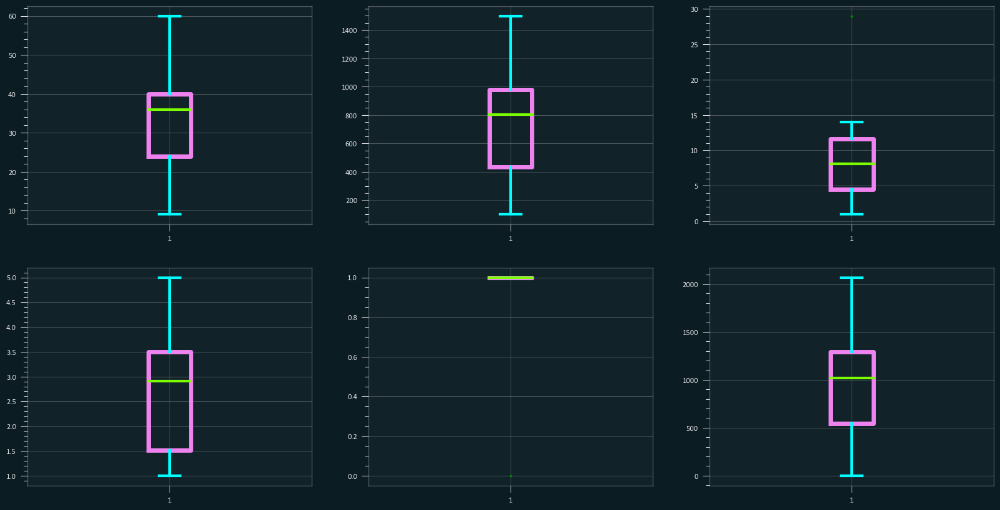

In [18]:
fig, axs = plt.subplots(nrows=2, ncols=3, figsize=(20,10))
for i, ax in enumerate(axs.flat):
    ax.boxplot(df1.iloc[:,i],boxprops=boxprops2,flierprops=flierprops,
            medianprops=medianprops,capprops=capprops,whiskerprops=whiskerprops)


# Histograms

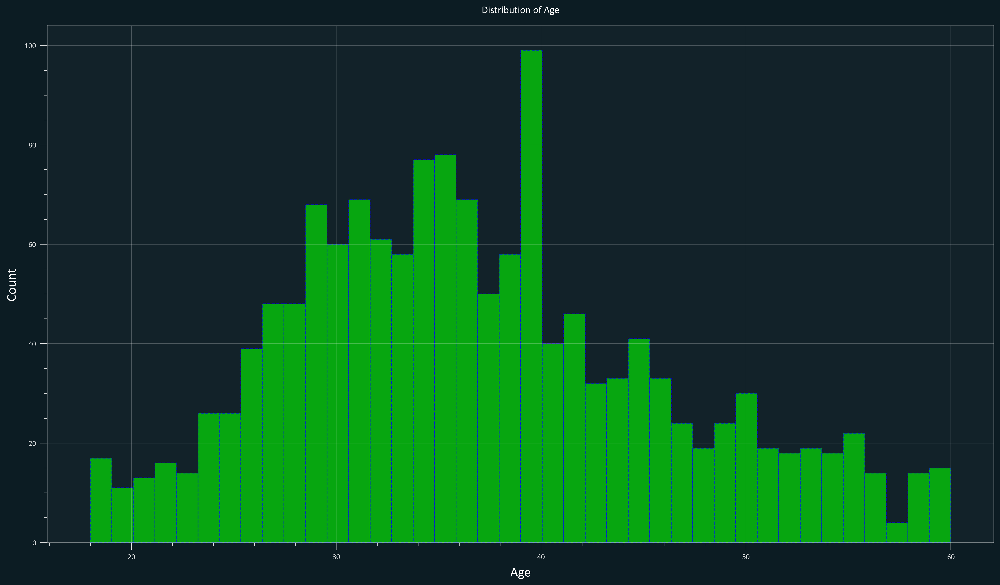

In [129]:
plt.figure(figsize = (20, 11), dpi = 400)
x = df['Age']
ax = plt.hist(x, bins=40, color='lime', edgecolor='blue',
         linestyle='--', alpha=0.6)
plt.title("Distribution of Age")
plt.rcParams.update({'font.size': 16})

plt.ylabel('Count')
 

plt.xlabel('Age')
 
plt.show()

Age is fairly divided amongst all the age groups but we can see that most of the people in the business are around 30 to 40 years old

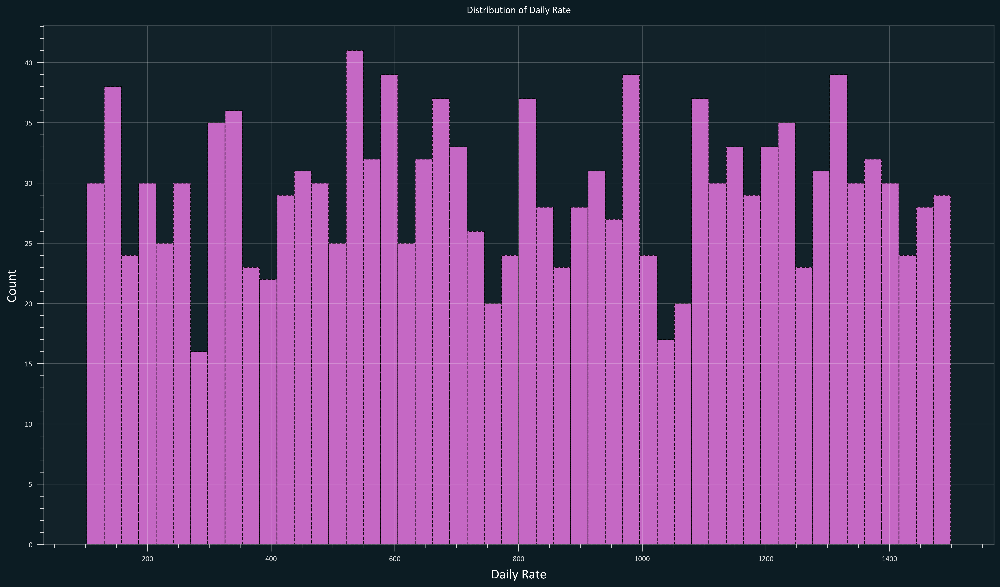

In [130]:
plt.figure(figsize = (20, 11), dpi = 400)
x = df['DailyRate']
ax = plt.hist(x, bins=50, color='orchid', edgecolor='black',
         linestyle='--', alpha=0.9)
plt.title("Distribution of Daily Rate")
 

plt.ylabel('Count')
 

plt.xlabel('Daily Rate')
 
plt.show()

In this plot we can see that the Daily rate is very fairly distrubuted in the organizastion, which means that there is a variety of jobs in the company which is paying different daily rates to the employees.

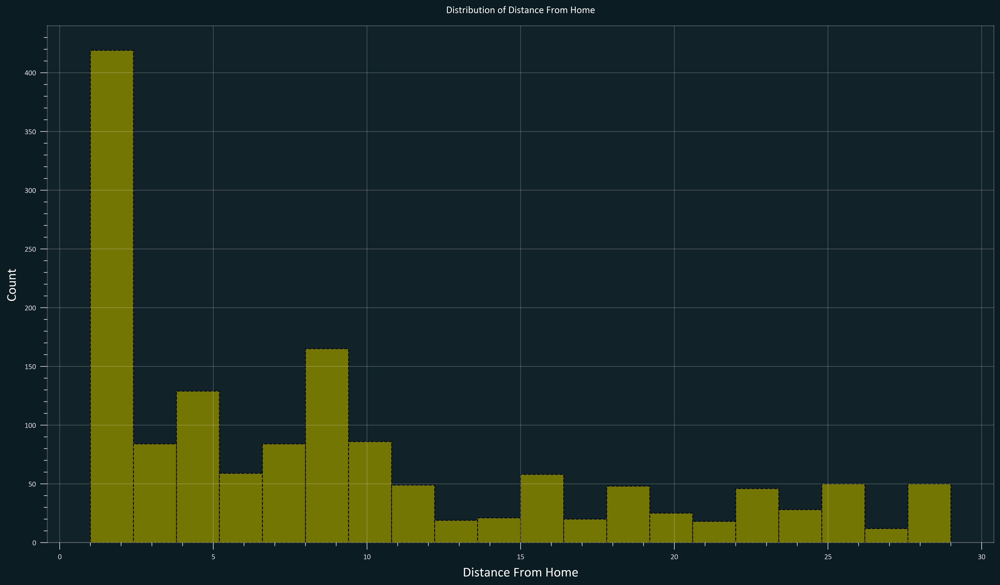

In [131]:
plt.figure(figsize = (20, 11), dpi = 400)
x = df['DistanceFromHome']
ax = plt.hist(x, bins=20, color='olive', edgecolor='black',
         linestyle='--', alpha=0.9)
plt.title("Distribution of Distance From Home")
 

plt.ylabel('Count')
 

plt.xlabel('Distance From Home')
 
plt.show()

From the above plot we can see that most of the people are coming from very close residents but the thing there is to notice is that there are also some people who are coming from almost 30 Kms away

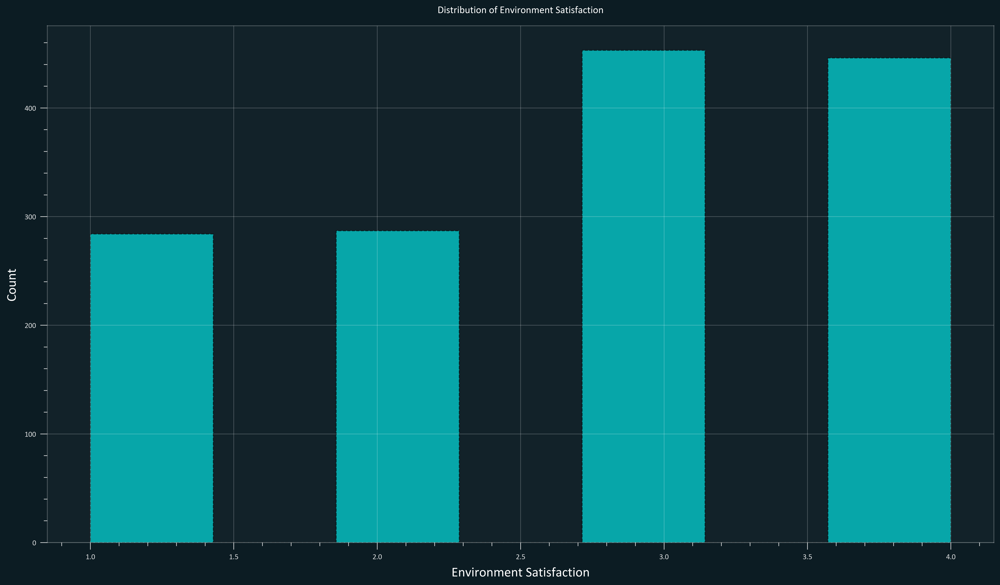

In [132]:
plt.figure(figsize = (20, 11), dpi = 400)
x = df['EnvironmentSatisfaction']
ax = plt.hist(x, bins=7, color='aqua', edgecolor='k',
         linestyle='--', alpha=0.6)
plt.title("Distribution of Environment Satisfaction")
 

plt.ylabel('Count')
 

plt.xlabel('Environment Satisfaction')
 
plt.show()

Every company want their satisfaction ratings to be good and in this case it is quiet safe to conclude that the environment rating to the company is good 

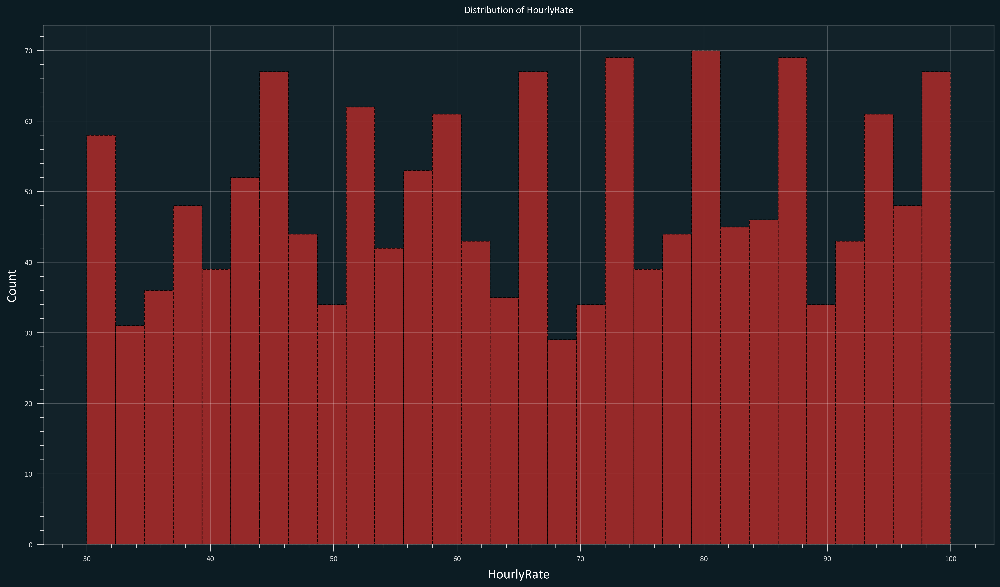

In [133]:
plt.figure(figsize = (20, 11), dpi = 400)
x = df['HourlyRate']
ax = plt.hist(x, bins=30, color='brown', edgecolor='k',
         linestyle='--', alpha=0.9)
plt.title("Distribution of HourlyRate")
 

plt.ylabel('Count')
 

plt.xlabel('HourlyRate')
 
plt.show()

As the Daily Rate we can also see that the Hourly Rate is also well dispersed across different ranges

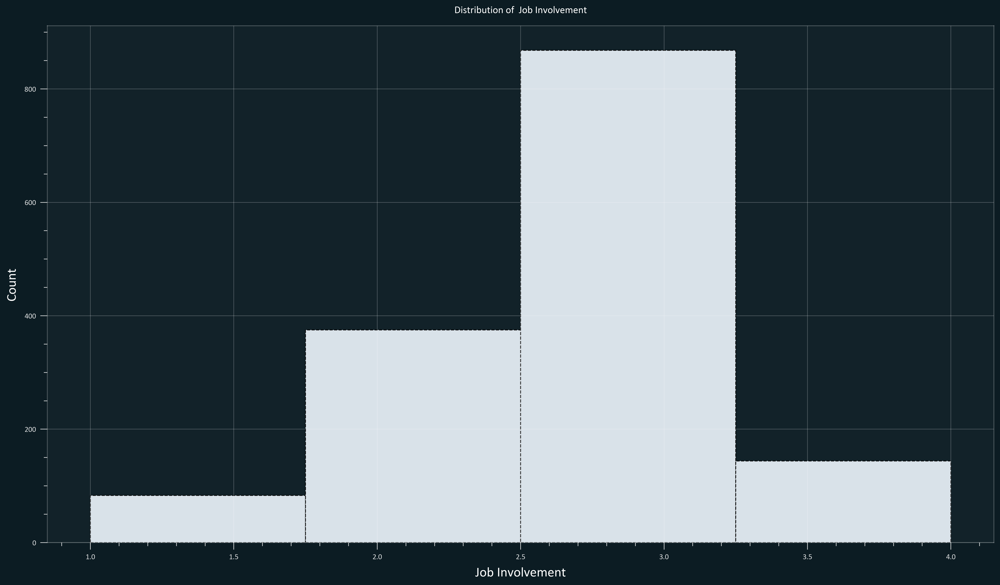

In [134]:
plt.figure(figsize = (20, 11), dpi = 400)
x = df['JobInvolvement']
ax = plt.hist(x, bins=4, color='aliceblue', edgecolor='k',
         linestyle='--', alpha=0.9)
plt.title("Distribution of  Job Involvement")
 

plt.ylabel('Count')
 

plt.xlabel('Job Involvement')
 
plt.show()

Job involvement is not very good as it lies in the range of 2.5 to 3 and very less people comes in the category above 3.5

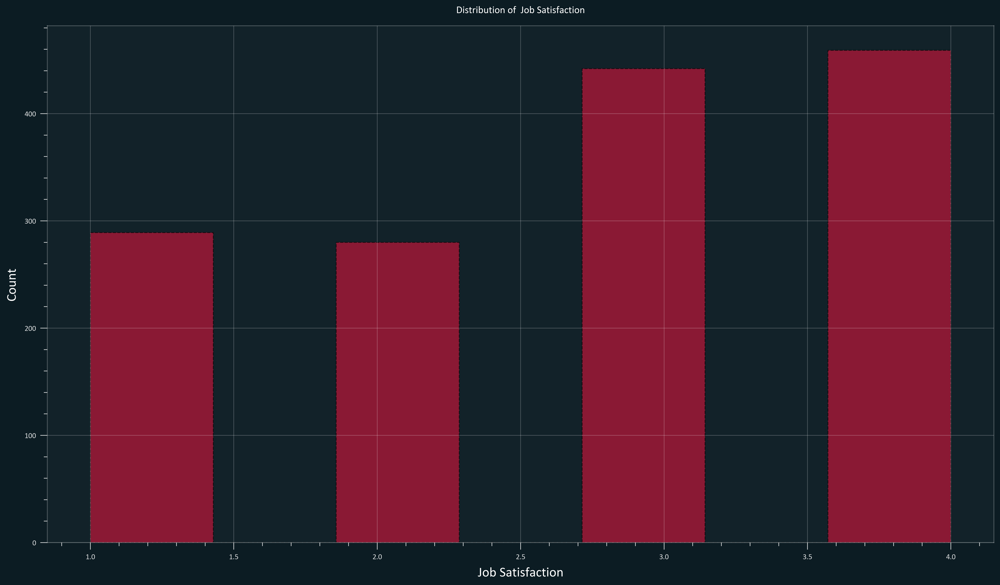

In [135]:
plt.figure(figsize = (20, 11), dpi = 400)
x = df['JobSatisfaction']
ax = plt.hist(x, bins=7, color='crimson', edgecolor='k',
         linestyle='--', alpha=0.6)
plt.title("Distribution of  Job Satisfaction")
 

plt.ylabel('Count')
 

plt.xlabel('Job Satisfaction')
 
plt.show()

Here also we can see that the Job Satisfaction of the company is fairly good

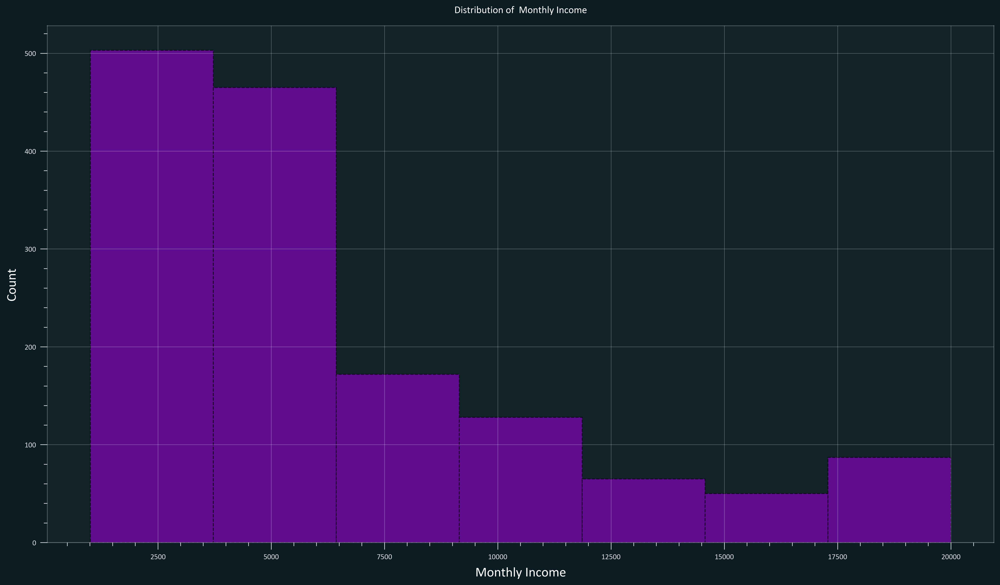

In [136]:
plt.figure(figsize = (20, 11), dpi = 400)
x = df['MonthlyIncome']
ax = plt.hist(x, bins=7, color='darkviolet', edgecolor='k',
         linestyle='--', alpha=0.6)
plt.title("Distribution of  Monthly Income")
 

plt.ylabel('Count')
 

plt.xlabel('Monthly Income')
 
plt.show()

We can clearly see that the people in the company are earning lesser amounts of income which means that more number of people are earning less income and less number of people are earning more income.

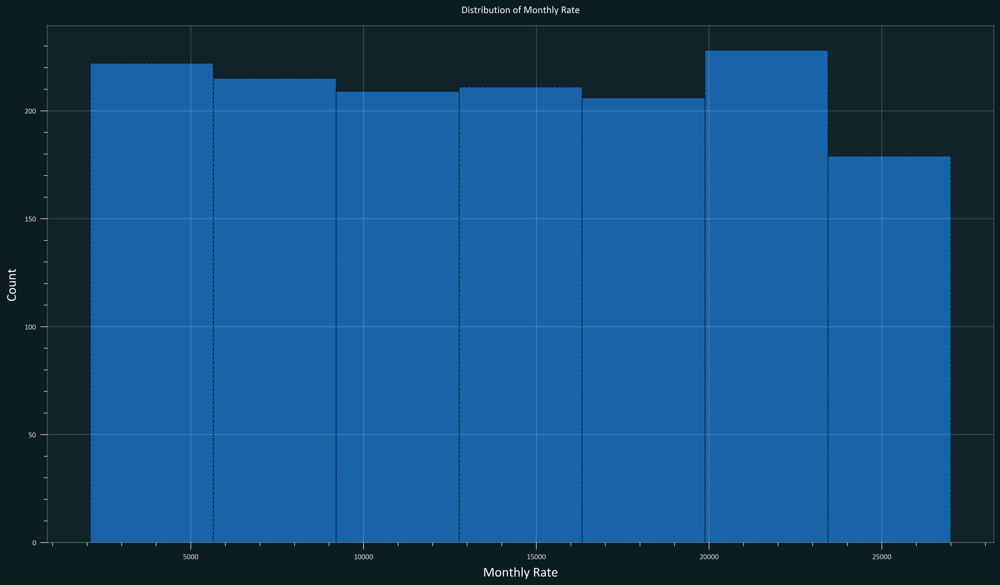

In [137]:
plt.figure(figsize = (20, 11), dpi = 400)
x = df['MonthlyRate']
ax = plt.hist(x, bins=7, color='dodgerblue', edgecolor='k',
         linestyle='--', alpha=0.6)
plt.title("Distribution of Monthly Rate")
 

plt.ylabel('Count')
 

plt.xlabel('Monthly Rate')
 
plt.show()

We can see that unlike the monthly income the monthly rate is well dispersed.

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\2182624314.py:3: UserWarning:

To output multiple subplots, the figure containing the passed axes is being cleared.



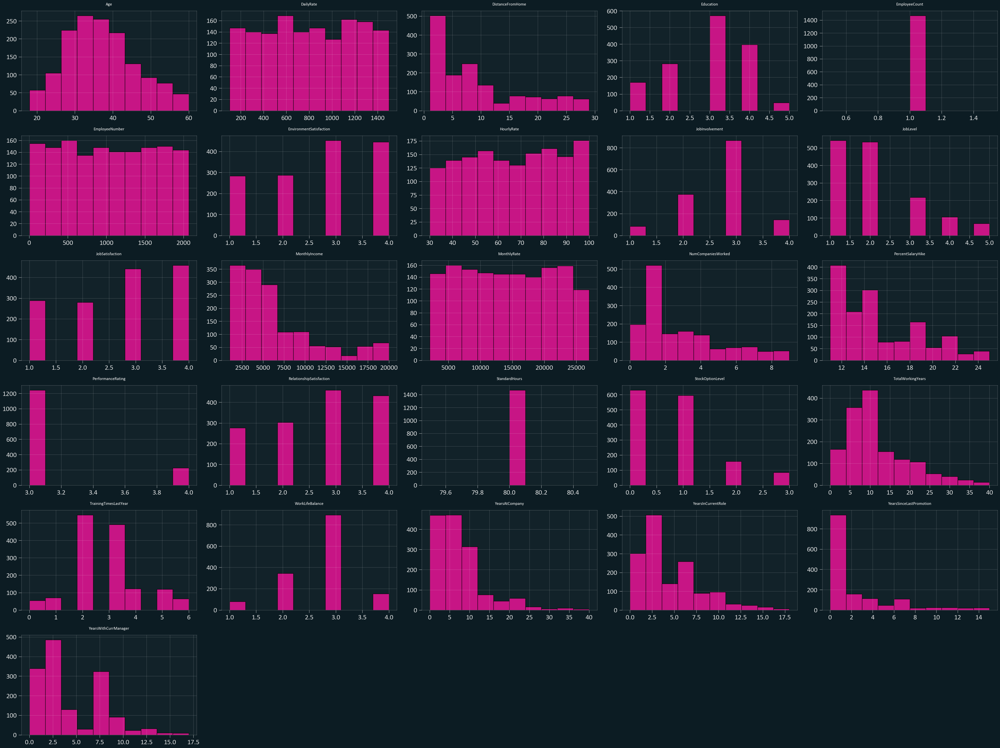

In [28]:
fig = plt.figure(figsize = (40,30))
ax = fig.gca()
df.hist(ax=ax, color='mediumvioletred', edgecolor='black',xlabelsize = 20, ylabelsize = 20)
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

To summarize all the plots!!

# Countplots

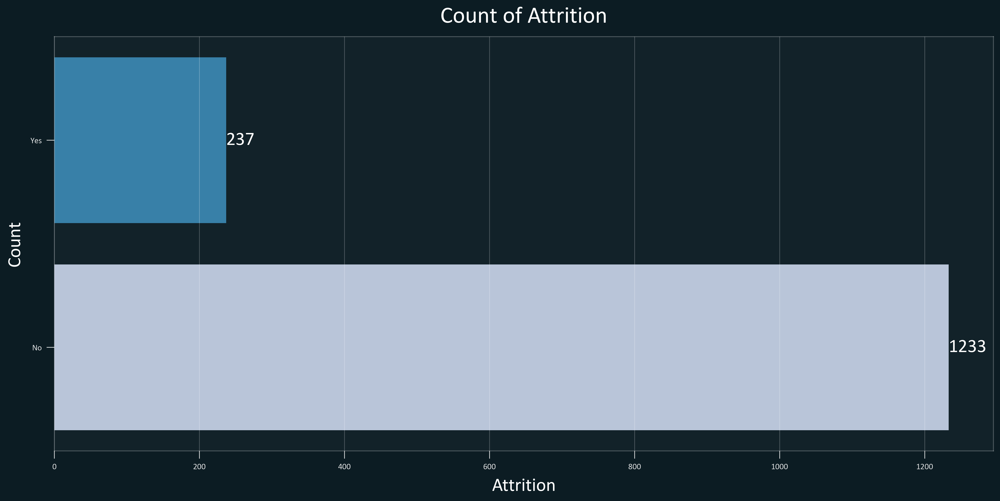

In [106]:
plt.figure(figsize = (18, 8), dpi=400)
ax = sns.countplot(y ='Attrition', data = df, palette= random.choice(palette_values))
ax.set_xlabel(xlabel = 'Attrition', fontsize = 20)
ax.set_ylabel(ylabel = 'Count', fontsize = 20)
ax.set_title(label = 'Count of Attrition', fontsize = 25) 
for i in ax.containers:
    ax.bar_label(i)

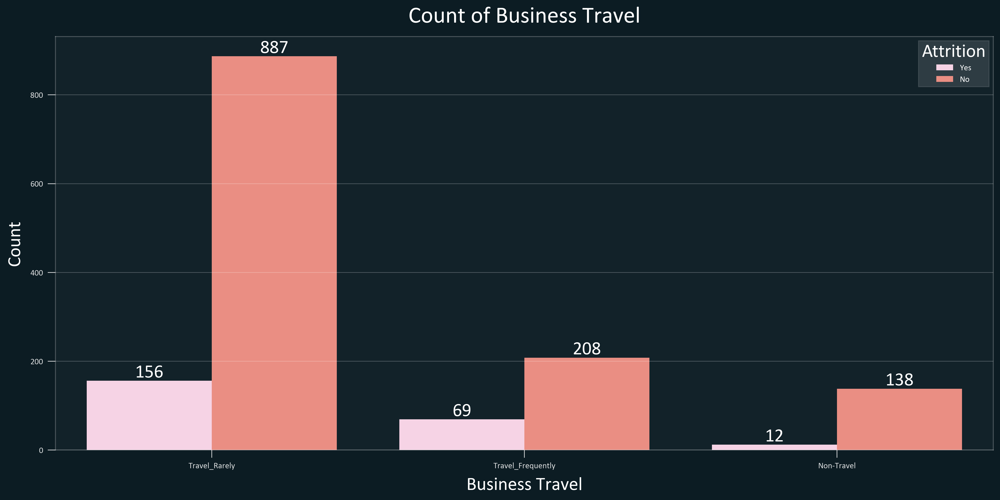

In [107]:
plt.figure(figsize = (18, 8), dpi=400)
ax = sns.countplot(x ='BusinessTravel',hue='Attrition', data = df, palette= random.choice(palette_values))
ax.set_xlabel(xlabel = 'Business Travel', fontsize = 20)
ax.set_ylabel(ylabel = 'Count', fontsize = 20)
ax.set_title(label = 'Count of Business Travel', fontsize = 25) 
for i in ax.containers:
    ax.bar_label(i)

If we take the absolute figure, most of the people who are leaving the organization are the one's who Travel Frequently.

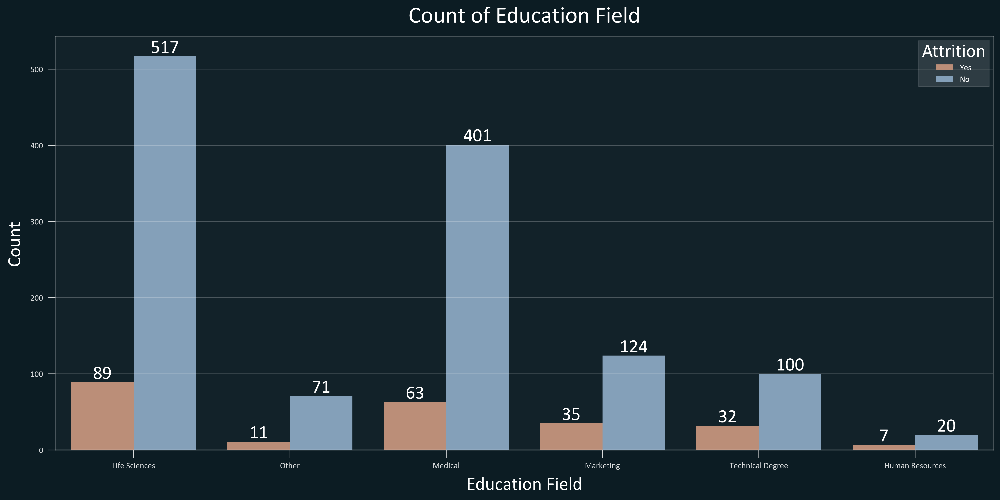

In [108]:
plt.figure(figsize = (18, 8), dpi=400)
ax = sns.countplot(x ='EducationField',hue='Attrition', data = df, palette= random.choice(palette_values))
ax.set_xlabel(xlabel = 'Education Field', fontsize = 20)
ax.set_ylabel(ylabel = 'Count', fontsize = 20)
ax.set_title(label = 'Count of Education Field', fontsize = 25) 
for i in ax.containers:
    ax.bar_label(i)

Most of the people are from the Life Sciences background and here also if we take the absolute figures Human Resource employees are the one who are leaving the organization more, compred to the other education feilds.

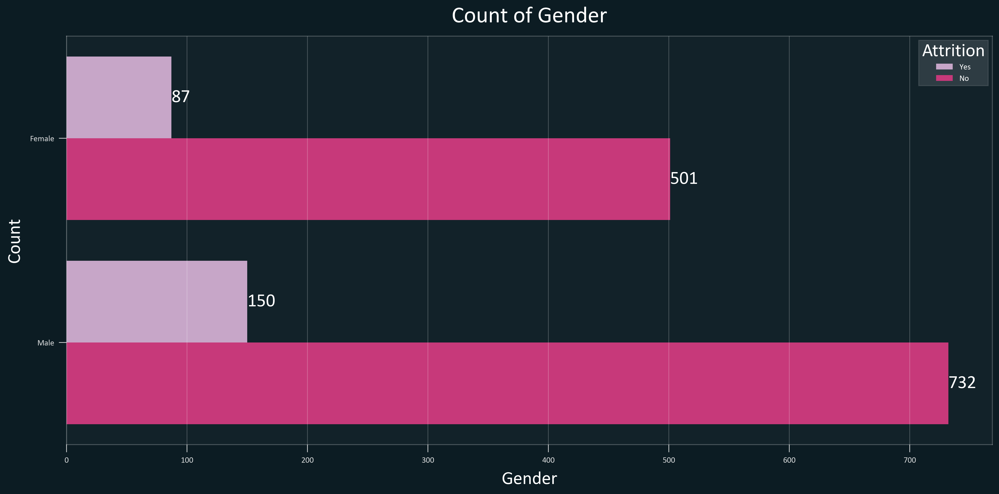

In [109]:
plt.figure(figsize = (18, 8), dpi=400)
ax = sns.countplot(y ='Gender', data = df,hue='Attrition', palette= random.choice(palette_values))
ax.set_xlabel(xlabel = 'Gender', fontsize = 20)
ax.set_ylabel(ylabel = 'Count', fontsize = 20)
ax.set_title(label = 'Count of Gender', fontsize = 25)
for i in ax.containers:
    ax.bar_label(i)

There are more number of males in the organization and relatively also males are leaving the organization more than the females.

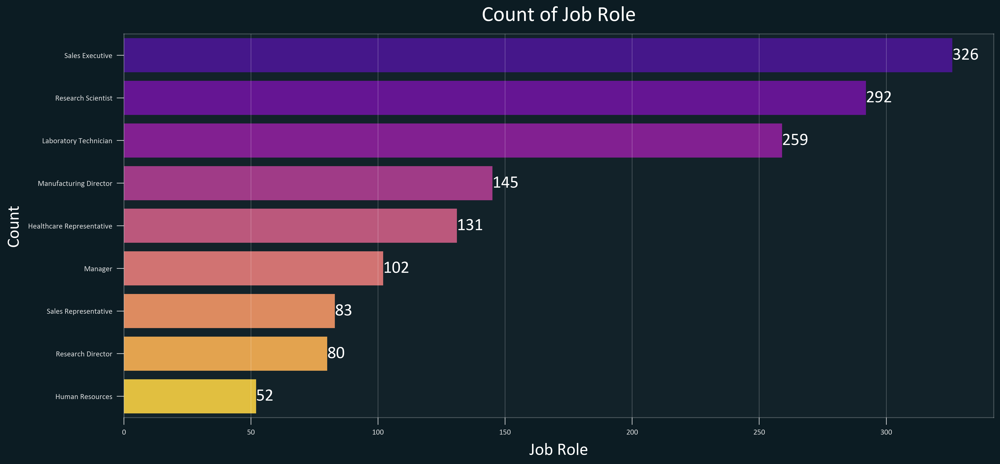

In [110]:
plt.figure(figsize = (18, 8), dpi=400)
ax = sns.countplot(y ='JobRole', data = df, palette= random.choice(palette_values))
ax.set_xlabel(xlabel = 'Job Role', fontsize = 20)
ax.set_ylabel(ylabel = 'Count', fontsize = 20)
ax.set_title(label = 'Count of Job Role', fontsize = 25)
for i in ax.containers:
    ax.bar_label(i)

We can see that most common job role of the company is Sales Exicutive.

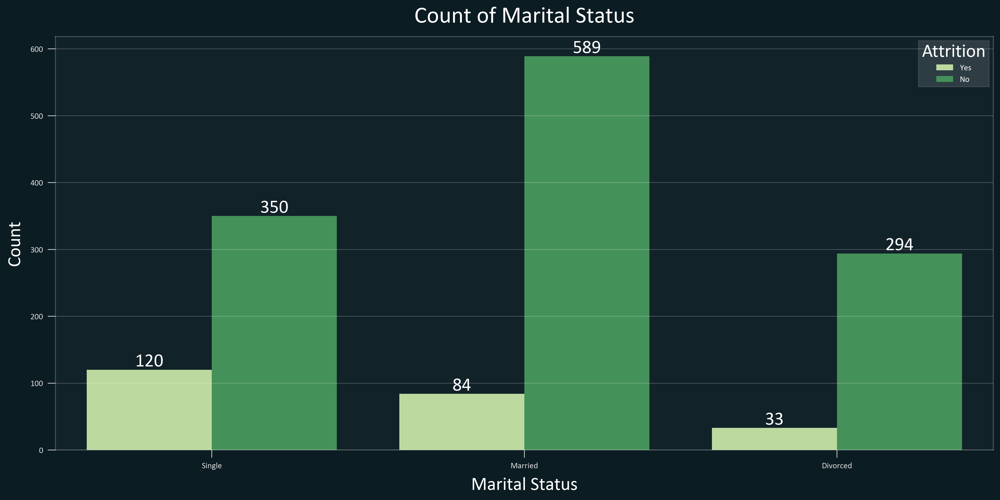

In [111]:
plt.figure(figsize = (18, 8), dpi=400)
ax = sns.countplot(x ='MaritalStatus', data = df,hue='Attrition', palette= random.choice(palette_values))
ax.set_xlabel(xlabel = 'Marital Status', fontsize = 20)
ax.set_ylabel(ylabel = 'Count', fontsize = 20)
ax.set_title(label = 'Count of Marital Status', fontsize = 25)
for i in ax.containers:
    ax.bar_label(i)

Most of the people leaving the organization are single.

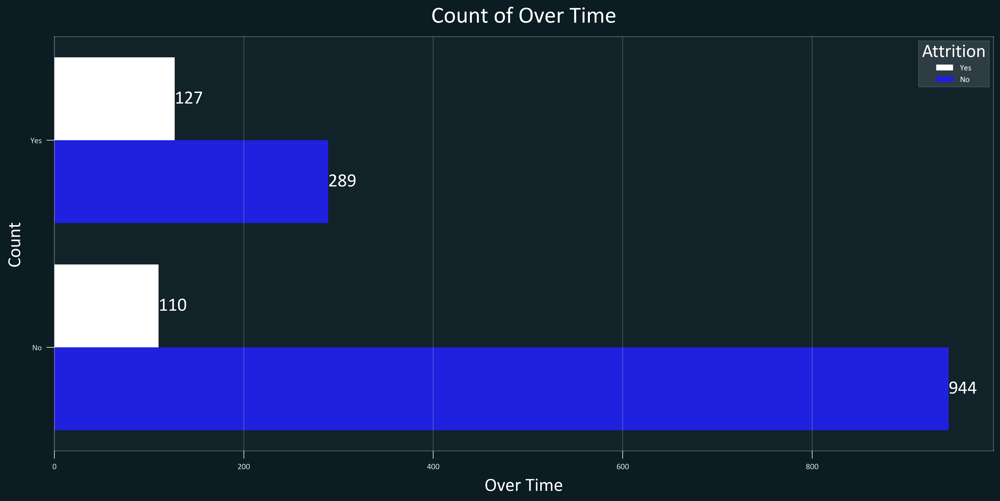

In [112]:
plt.figure(figsize = (18, 8), dpi=400)
ax = sns.countplot(y ='OverTime', data = df,hue='Attrition', palette= random.choice(palette_values))
ax.set_xlabel(xlabel = 'Over Time', fontsize = 20)
ax.set_ylabel(ylabel = 'Count', fontsize = 20)
ax.set_title(label = 'Count of Over Time', fontsize = 25)
for i in ax.containers:
    ax.bar_label(i)

We can clearly see that overtime is one of the main reasons why the people are leaving the organization.

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\326528726.py:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



Text(0.5, 1.0, 'Job Role wise Income')

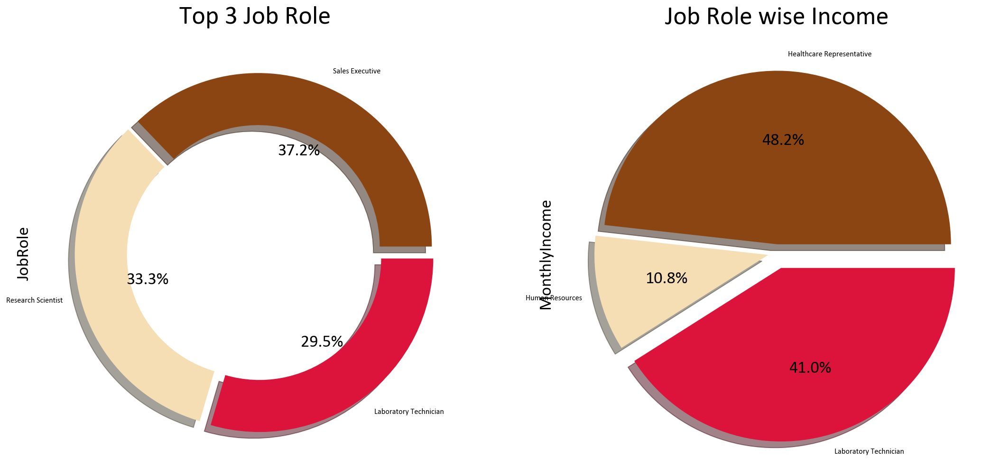

In [114]:
fig = plt.figure(figsize=(20,12), dpi=130)
colors = ['saddlebrown', 'wheat', 'crimson']
ax1 = plt.subplot2grid((1,2),(0,0))
explode = (0.04, 0.04,0.04)
df['JobRole'].value_counts().head(3).plot(kind ='pie', autopct='%1.1f%%', colors=colors, explode=explode, shadow=True,wedgeprops={'width': 0.3})
plt.title('Top 3 Job Role', fontsize=30)
ax1 = plt.subplot2grid((1,2), (0,1))
explode = (0.05,0.05,0.09)
df.groupby(by = 'JobRole').sum()['MonthlyIncome'].head(3).plot(kind ='pie', autopct='%1.1f%%', colors=colors, explode=explode, shadow=True)
plt.title('Job Role wise Income', fontsize=30)

From the above plot we can see that 
- Most common job is Sales Executive, but when it comes to most high paying jobs these are Healthcare Representative followed by Laboratory Technician.

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\621161147.py:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



Text(0.5, 1.0, 'Department wise Income')

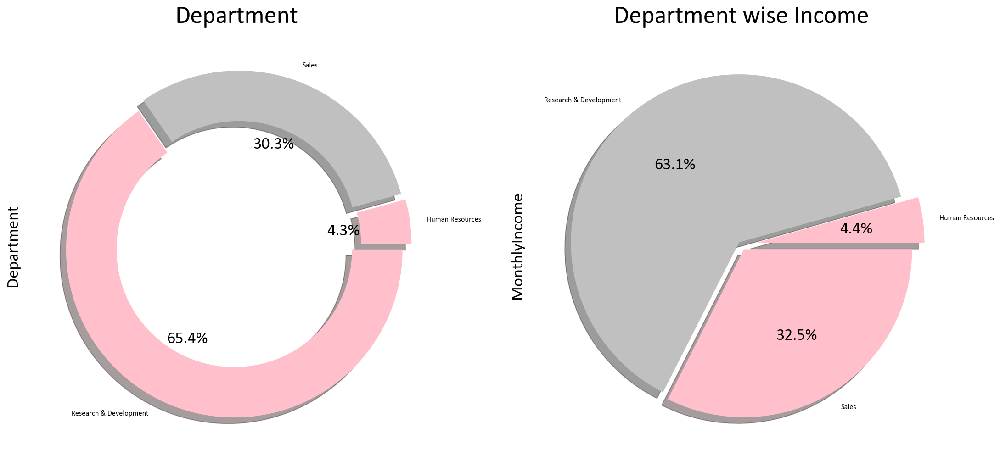

In [115]:
fig = plt.figure(figsize=(20,12), dpi=130)
ax1 = plt.subplot2grid((1,2),(0,0))
explode = (0.03,0.04,0.04)
colors = ['pink', 'silver']
df['Department'].value_counts().plot(kind ='pie',autopct='%1.1f%%', colors=colors, explode=explode, shadow=True,counterclock=False,wedgeprops={'width': 0.3})
plt.title('Department', fontsize=30)
ax1 = plt.subplot2grid((1,2), (0,1))
explode = (0.09, 0.02,0.03)
df.groupby(by = 'Department').sum()['MonthlyIncome'].plot(kind ='pie', autopct='%1.1f%%', colors=colors, explode=explode, shadow=True,)
plt.title('Department wise Income', fontsize=30)

We can see that the Research and development is the most common as well as the highest paying department.

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\741157089.py:9: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



Text(0.5, 1.0, 'Education Field wise Hourly Rate')

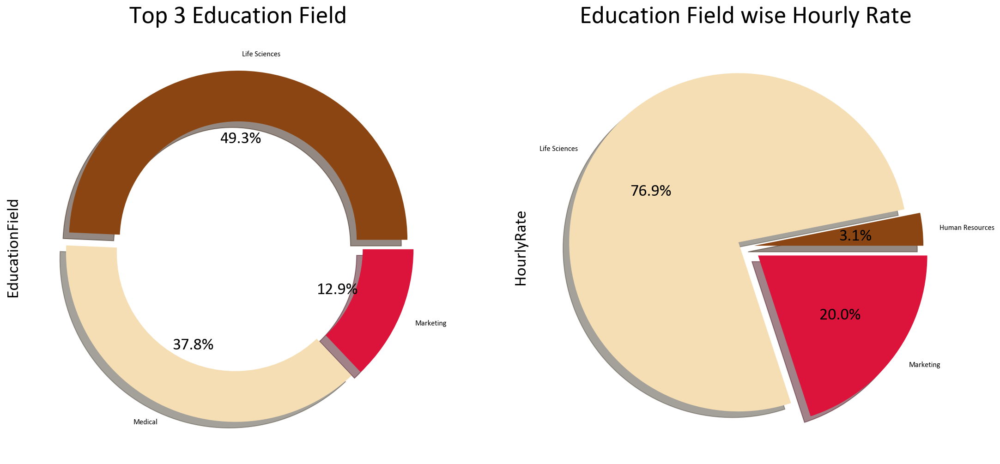

In [116]:
fig = plt.figure(figsize=(20,12), dpi=130)
colors = ['saddlebrown', 'wheat', 'crimson']
ax1 = plt.subplot2grid((1,2),(0,0))
explode = (0.04, 0.04,0.04)
df['EducationField'].value_counts().head(3).plot(kind ='pie', autopct='%1.1f%%', colors=colors, explode=explode, shadow=True,wedgeprops={'width': 0.3})
plt.title('Top 3 Education Field', fontsize=30)
ax1 = plt.subplot2grid((1,2), (0,1))
explode = (0.05,0.05,0.09)
df.groupby(by = 'EducationField').sum()['HourlyRate'].head(3).plot(kind ='pie', autopct='%1.1f%%', colors=colors, explode=explode, shadow=True)
plt.title('Education Field wise Hourly Rate', fontsize=30)

We can clearly see that life sciences is a very common role as well as a high paying role.

<Figure size 2600x1560 with 0 Axes>

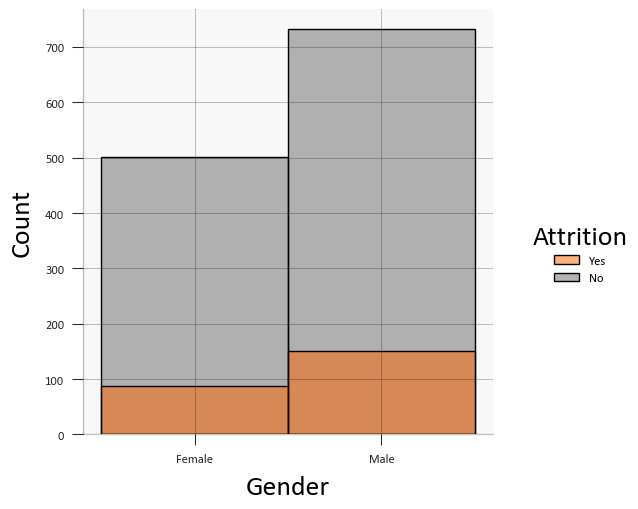

In [84]:
plt.figure(figsize=(20,12), dpi=130)
sns.displot(data = df, x = "Gender", hue = "Attrition", height = 5.5)

Considering both absolute and percentage values, Male attrition is more than Female attrition.

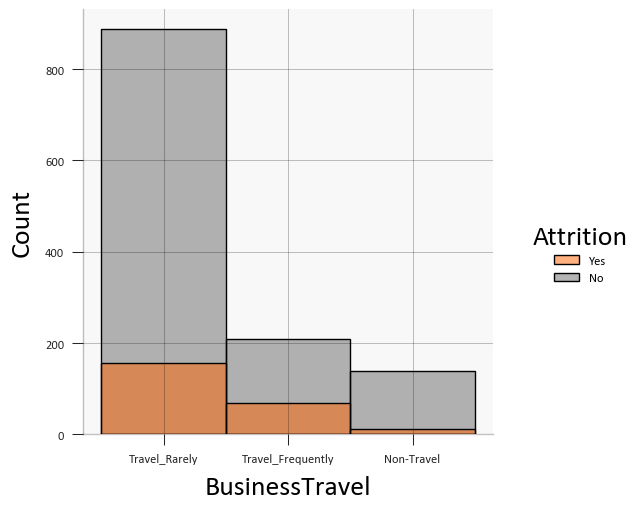

In [85]:
sns.displot(data = df, x = "BusinessTravel", hue = "Attrition", height = 5.5)

Considering absolute values, employees traveling rarely resigned/retired mostly (156 employes) and when percentage values are considered, employees traveling frequently resigned/retired mostly (around 25%).

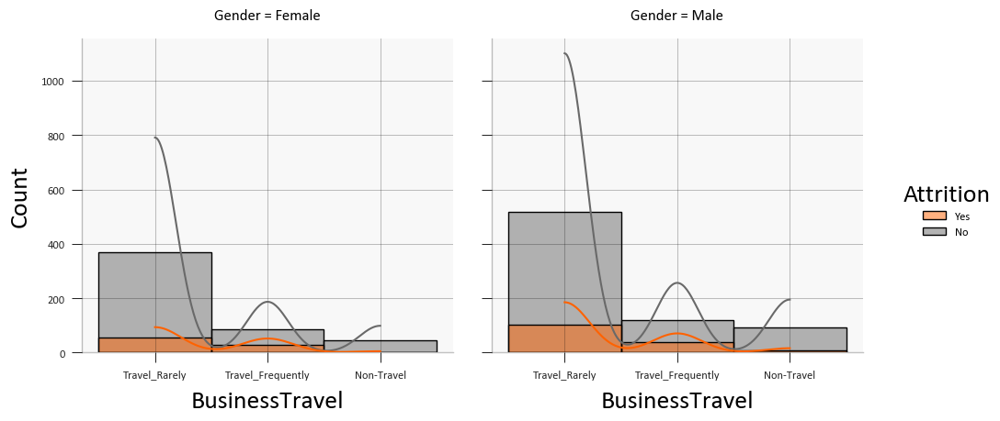

In [86]:
ax = sns.displot(df, x="BusinessTravel", hue="Attrition",col='Gender', kde='True')

<Axes: xlabel='Age', ylabel='Count'>

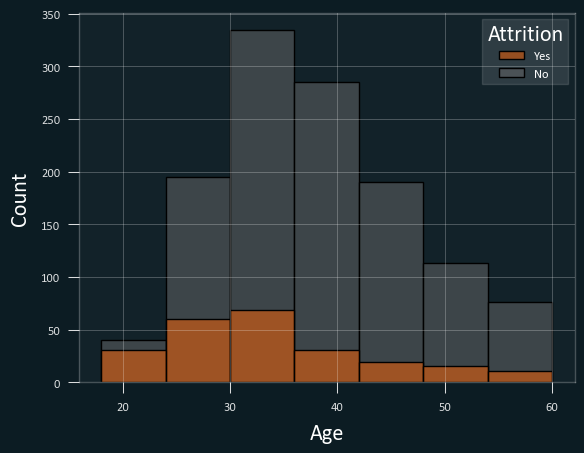

In [42]:
sns.histplot(data = df, x = "Age", bins = 7, hue = "Attrition")

From above histogram, we can get to know that most of the employees (82%) fall in the working age between 24 and 48.

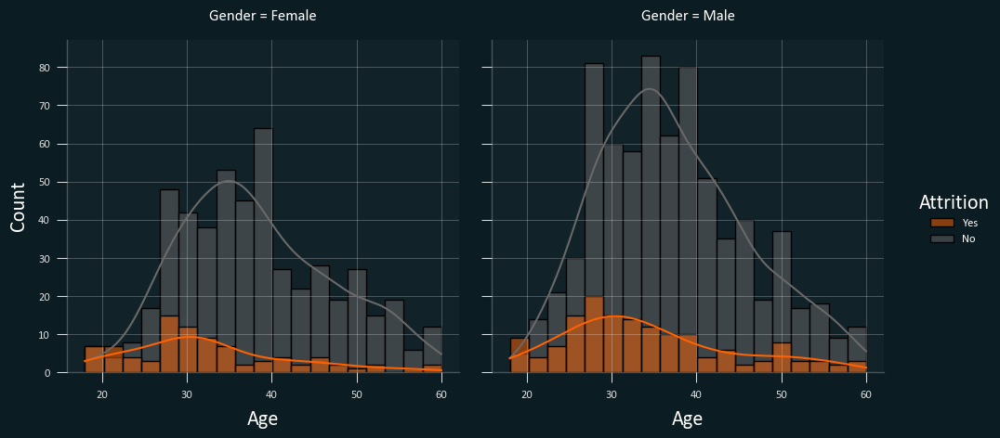

In [43]:
ax = sns.displot(df, x="Age", hue="Attrition",col='Gender', kde='True')

We can infer that around 45% of the employees whose age is less than 24 resign. This number should also be a cause of worry for top-level management.

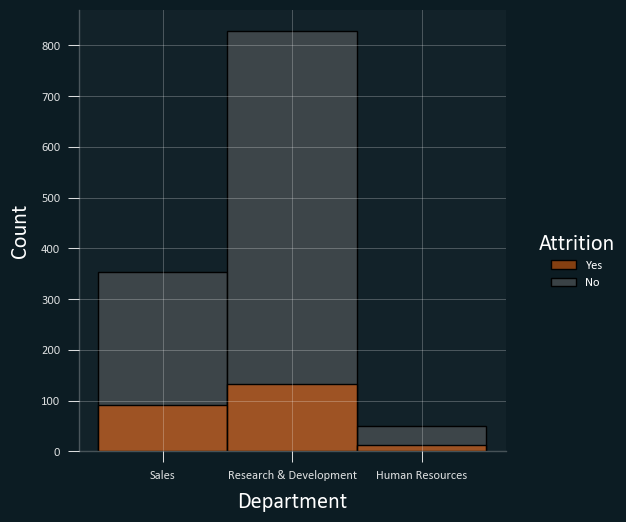

In [44]:
sns.displot(data = df, x = "Department", hue = "Attrition", height = 5.5)

Absolute number (133) of employees resigning from R&D is more but percentage-wise Sales and HR of employees resign/retire from Sales and HR respectively.

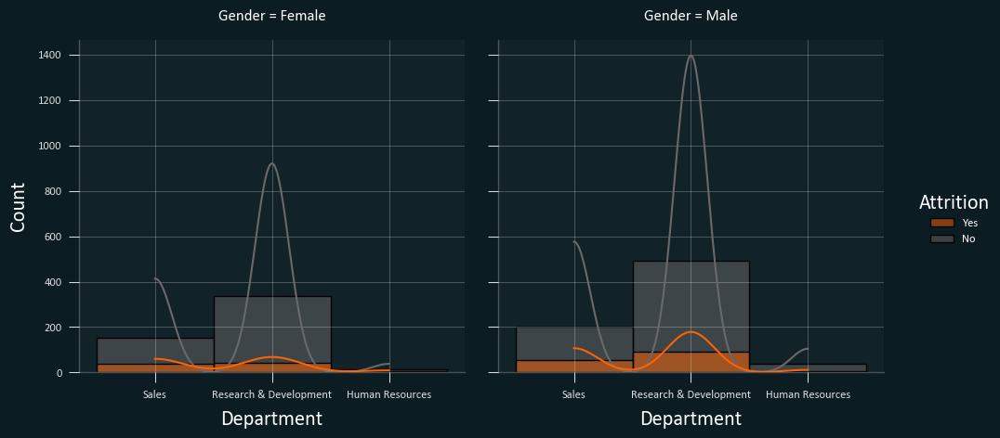

In [45]:
ax = sns.displot(df, x="Department", hue="Attrition",col='Gender', kde='True')

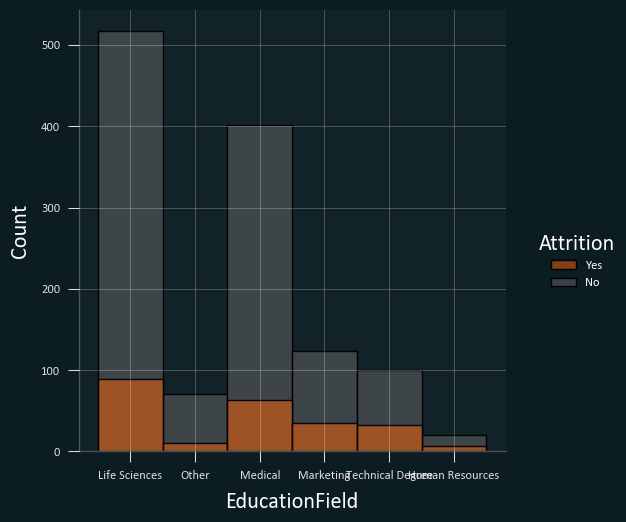

In [46]:
sns.displot(data = df, x = "EducationField", hue = "Attrition", height = 5.5)

When absolute numbers are compared, employees in Life Sciences Department resign most. But when percentages are compared, employees in HR Department resign/retire most (around 26%).

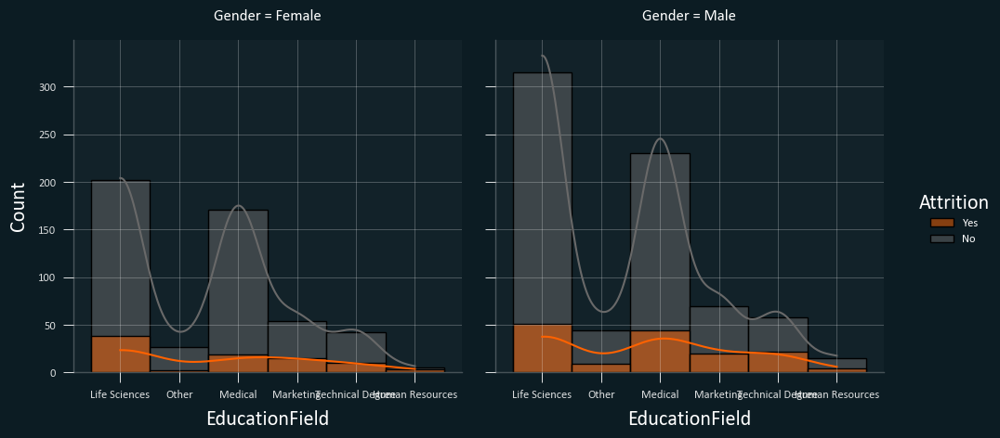

In [47]:
ax = sns.displot(df, x="EducationField", hue="Attrition",col='Gender', kde='True')

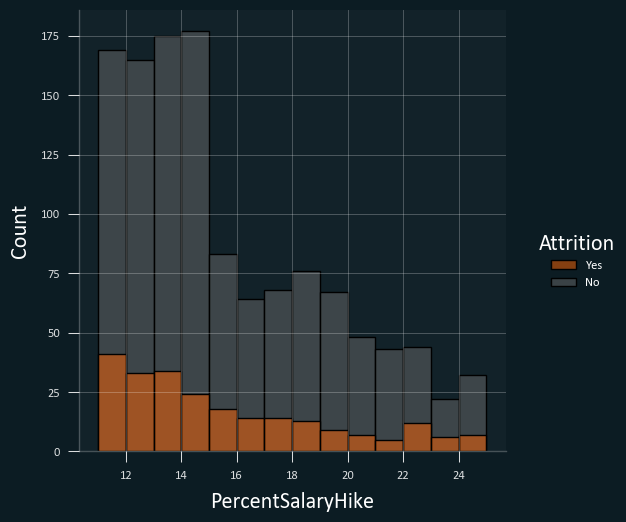

In [48]:
sns.displot(data = df, x = "PercentSalaryHike", hue = "Attrition", height = 5.5)

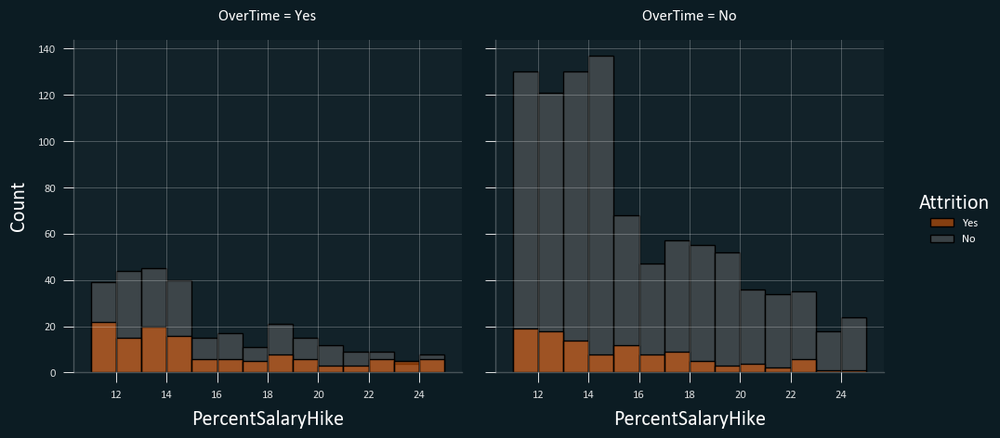

In [49]:
sns.displot(data = df, x = "PercentSalaryHike", hue = "Attrition", col = "OverTime")

From the above distribution plot, we can infer that even after working overtime, if employees do get a good salary hike, they resign. But the thing to be noted is working overtime doesn’t mean working productively.

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\3724111559.py:1: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\3724111559.py:1: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\3724111559.py:1: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of nume

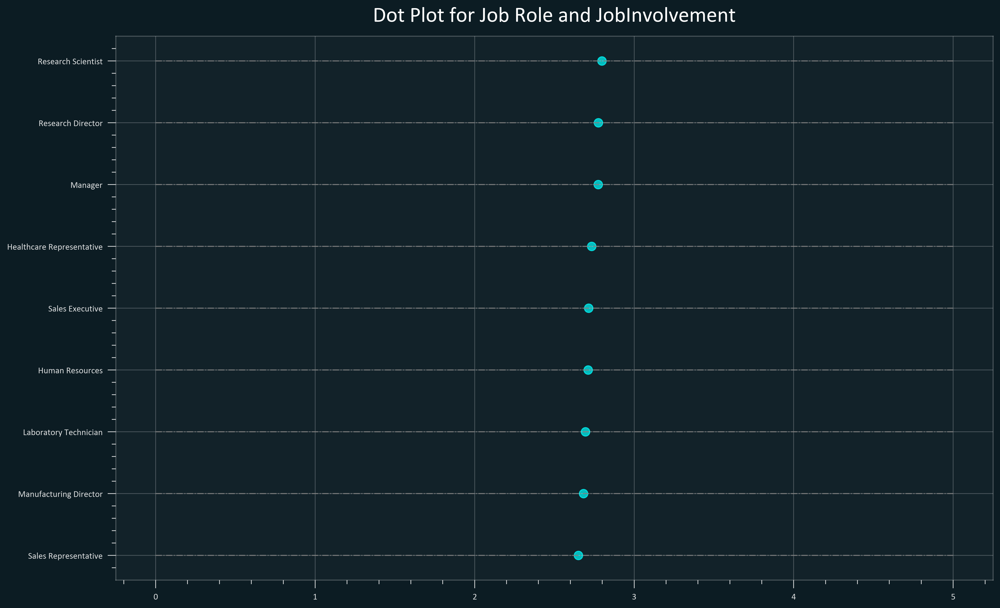

In [50]:
df1 = df[['JobInvolvement', 'JobRole']].groupby('JobRole').apply(lambda x: x.mean())
df1.sort_values('JobInvolvement', inplace=True)
df1.reset_index(inplace=True)
# Draw plot

fig, ax = plt.subplots(figsize=(16,10), dpi= 400)
plt.rcParams.update({'font.size': 20})
ax.hlines(y=df1.index, xmin=0, xmax=5, color='gray', alpha=0.9, linewidth=1, linestyles='dashdot')
ax.scatter(y=df1.index, x=df1.JobInvolvement, s=75, color='cyan', alpha=0.7)

ax.set_title('Dot Plot for Job Role and JobInvolvement', fontdict={'size':22})
ax.set_yticks(df1.index)
ax.set_yticklabels(df1.JobRole.str.title(), fontdict={'horizontalalignment': 'right'})
plt.show()

From the above plot we can see that Research Scientist roles is the job requiring the most involvment by the employees, this can be one of the reasons why it is the most highest paying job.

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\3900362116.py:1: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\3900362116.py:1: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\3900362116.py:1: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of nume

([<matplotlib.axis.XTick at 0x207001f85e0>,
 [Text(0, 0, 'SALES REPRESENTATIVE'),
  Text(1, 0, 'MANUFACTURING DIRECTOR'),
  Text(2, 0, 'LABORATORY TECHNICIAN'),
  Text(3, 0, 'HUMAN RESOURCES'),
  Text(4, 0, 'SALES EXECUTIVE'),
  Text(5, 0, 'HEALTHCARE REPRESENTATIVE'),
  Text(6, 0, 'MANAGER'),
  Text(7, 0, 'RESEARCH DIRECTOR'),
  Text(8, 0, 'RESEARCH SCIENTIST')])

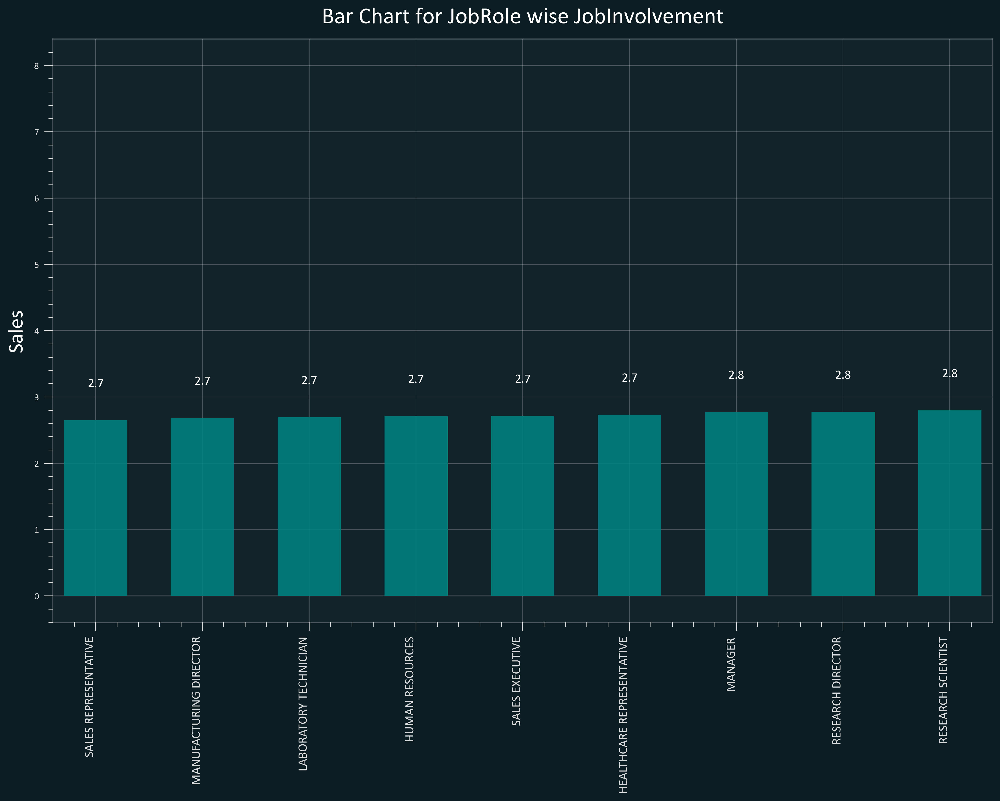

In [51]:
df2 = df[['JobInvolvement', 'JobRole']].groupby('JobRole').apply(lambda x: x.mean())
df2.sort_values('JobInvolvement', inplace=True)
df2.reset_index(inplace=True)


fig, ax = plt.subplots(figsize=(16,10), dpi= 400)
plt.rcParams.update({'font.size': 20})
ax.hlines(y=df2.index, xmin=0, xmax=4, color='gray', alpha=0.9, linewidth=0, linestyles='dashdot')
ax.vlines(x=df2.index, ymin=0, ymax=df2.JobInvolvement, color='teal', alpha=0.9, linewidth=60)

for i, cty in enumerate(df2.JobInvolvement):
    ax.text(i, cty+0.5, round(cty, 1), horizontalalignment='center', fontsize=12)
    
# Title, Label, Ticks and Ylim
ax.set_title('Bar Chart for JobRole wise JobInvolvement', fontdict={'size':22})
ax.set(ylabel='Sales')
plt.xticks(df2.index, df2.JobRole.str.upper(), rotation=90, horizontalalignment='right', fontsize=12)

#### This is a same bar plot  for the above observation(a little bit less pleasing to the eyes, but providing us with the exact Job involvement in different Job Roles).

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\1273955025.py:1: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\1273955025.py:1: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\1273955025.py:1: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of nume

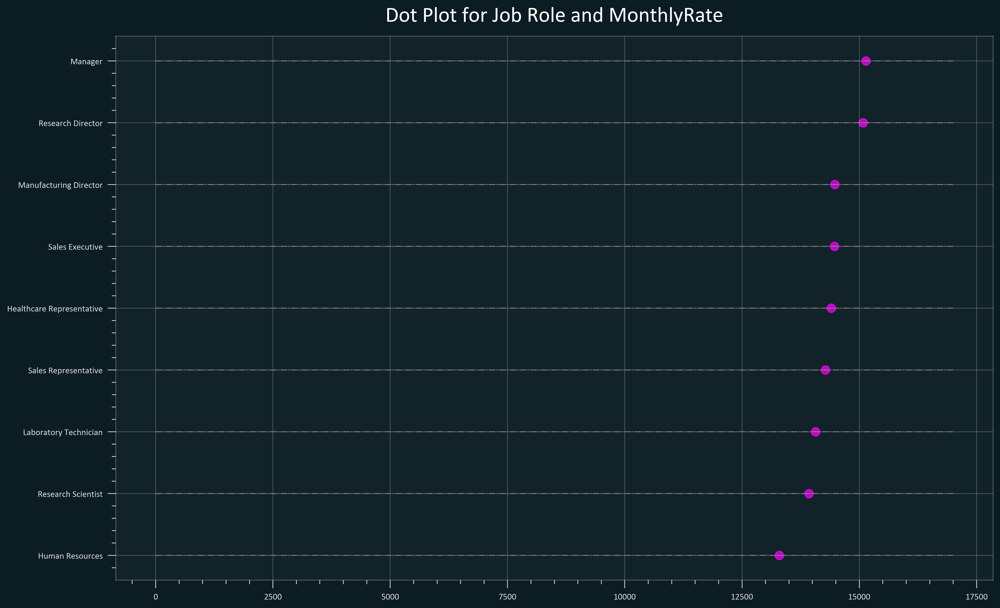

In [52]:
df1 = df[['MonthlyRate', 'JobRole']].groupby('JobRole').apply(lambda x: x.mean())
df1.sort_values('MonthlyRate', inplace=True)
df1.reset_index(inplace=True)

# Draw plot
fig, ax = plt.subplots(figsize=(16,10), dpi= 400)
plt.rcParams.update({'font.size': 20})
ax.hlines(y=df1.index, xmin=0, xmax=17000, color='gray', alpha=0.9, linewidth=1, linestyles='dashdot')
ax.scatter(y=df1.index, x=df1.MonthlyRate, s=75, color='fuchsia', alpha=0.7)

ax.set_title('Dot Plot for Job Role and MonthlyRate', fontdict={'size':22})
ax.set_yticks(df1.index)
ax.set_yticklabels(df1.JobRole.str.title(), fontdict={'horizontalalignment': 'right'})
plt.show()

It is quiet obvious that the manager is getting the highes rate out off all the other roles as he/she manages the other roles as well. 

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\2039527972.py:1: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\2039527972.py:1: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\2039527972.py:1: FutureWarning:

The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of nume

([<matplotlib.axis.XTick at 0x20700bb5160>,
 [Text(0, 0, 'HUMAN RESOURCES'),
  Text(1, 0, 'RESEARCH SCIENTIST'),
  Text(2, 0, 'LABORATORY TECHNICIAN'),
  Text(3, 0, 'SALES REPRESENTATIVE'),
  Text(4, 0, 'HEALTHCARE REPRESENTATIVE'),
  Text(5, 0, 'SALES EXECUTIVE'),
  Text(6, 0, 'MANUFACTURING DIRECTOR'),
  Text(7, 0, 'RESEARCH DIRECTOR'),
  Text(8, 0, 'MANAGER')])

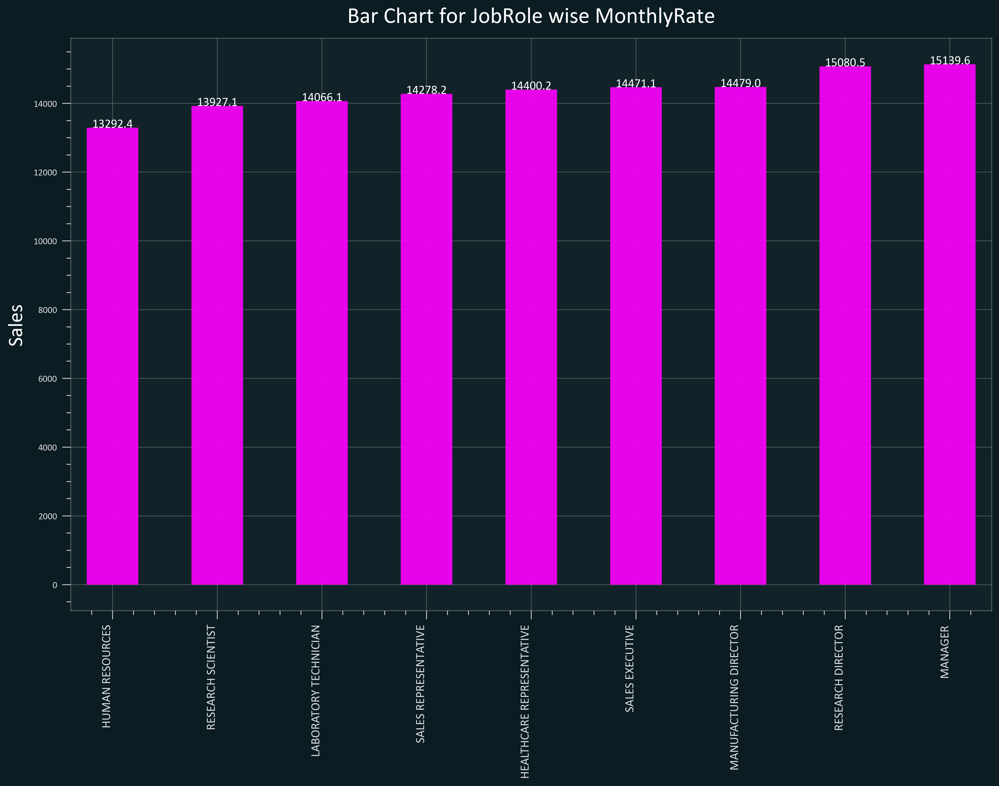

In [53]:
df2 = df[['MonthlyRate', 'JobRole']].groupby('JobRole').apply(lambda x: x.mean())
df2.sort_values('MonthlyRate', inplace=True)
df2.reset_index(inplace=True)


fig, ax = plt.subplots(figsize=(16,10), dpi= 400)
plt.rcParams.update({'font.size': 20})
ax.hlines(y=df2.index, xmin=0, xmax=4, color='gray', alpha=0.9, linewidth=0, linestyles='dashdot')
ax.vlines(x=df2.index, ymin=0, ymax=df2.MonthlyRate, color='fuchsia', alpha=0.9, linewidth=50)

for i, cty in enumerate(df2.MonthlyRate):
    ax.text(i, cty+0.5, round(cty, 1), horizontalalignment='center', fontsize=12)
    
# Title, Label, Ticks and Ylim
ax.set_title('Bar Chart for JobRole wise MonthlyRate', fontdict={'size':22})
ax.set(ylabel='Sales')
plt.xticks(df2.index, df2.JobRole.str.upper(), rotation=90, horizontalalignment='right', fontsize=12)

#### This is a same bar plot  for the above observation(a little bit less pleasing to the eyes, but providing us with the exact Rates in different Job roles).

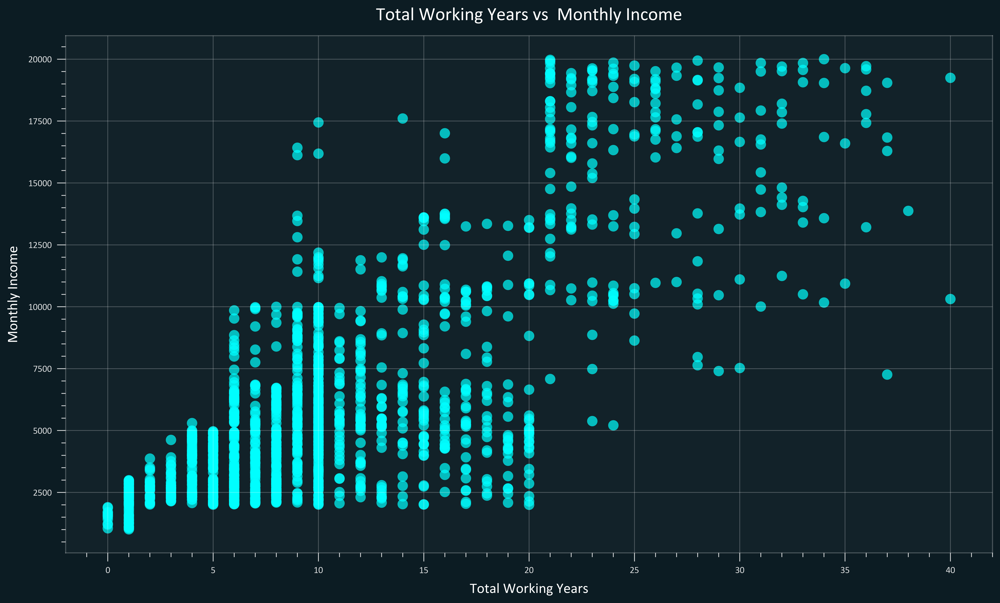

In [138]:
plt.figure(figsize=(16, 9), dpi= 600)
plt.scatter(df['TotalWorkingYears'], df['MonthlyIncome'], s=100, c='cyan', alpha=0.7, edgecolors='none')
plt.title('Total Working Years vs  Monthly Income', fontsize=18)
plt.xlabel('Total Working Years', fontsize=14)
plt.ylabel('Monthly Income', fontsize=14)
plt.grid(True)
plt.show()

We can clearly see that more number of experience is getting you more income.

In [55]:
fig = px.scatter(df, x="TotalWorkingYears", y="MonthlyIncome", color="PerformanceRating", title='')
fig.show()

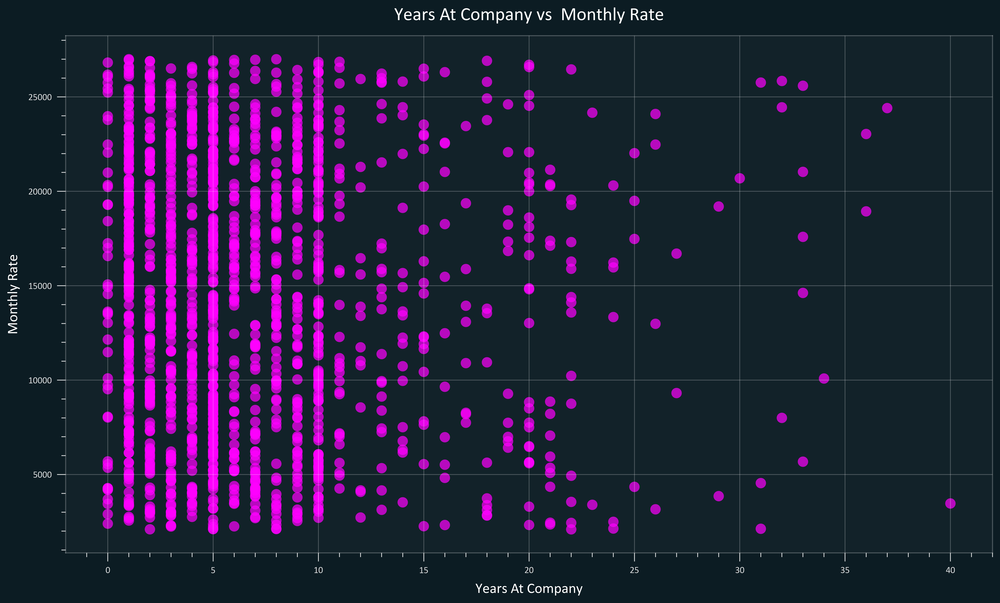

In [139]:
plt.figure(figsize=(16, 9), dpi= 600)
plt.scatter(df['YearsAtCompany'], df['MonthlyRate'], s=100, c='fuchsia', alpha=0.7, edgecolors='none')
plt.title('Years At Company vs  Monthly Rate', fontsize=18)
plt.xlabel('Years At Company', fontsize=14)
plt.ylabel('Monthly Rate', fontsize=14)
plt.grid(True)
plt.show()

In the above plot we can't see any kind of relationship between Years at company and monthly rate, which is quiet strange.

In [57]:
fig = px.scatter(df, x="YearsAtCompany", y="MonthlyRate", color="RelationshipSatisfaction", title='')
fig.show()

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\2293416742.py:25: UserWarning:

FixedFormatter should only be used together with FixedLocator



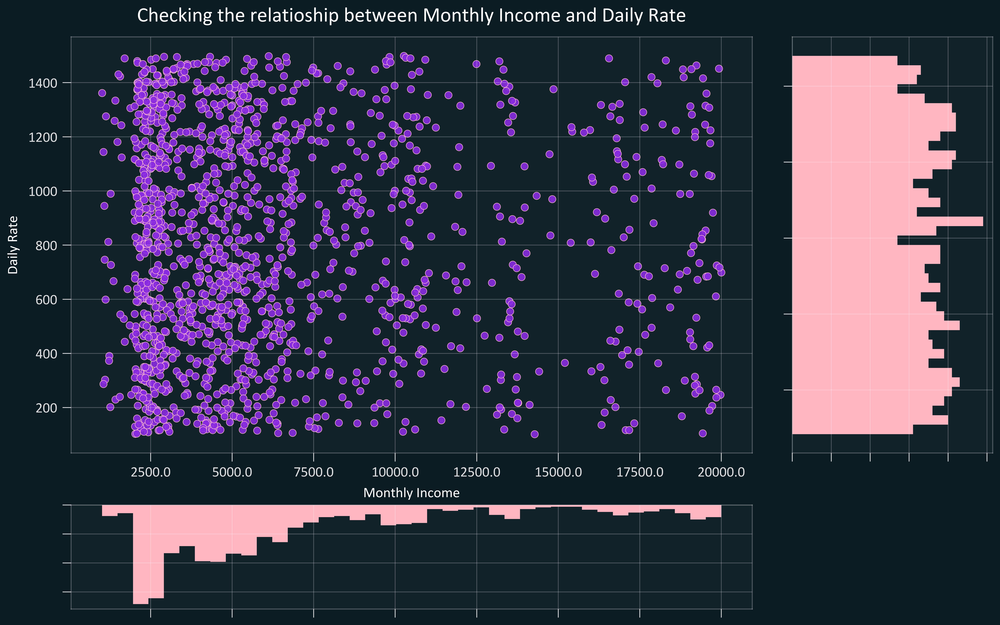

In [58]:
fig = plt.figure(figsize=(16, 10), dpi= 600)
grid = plt.GridSpec(4, 4, hspace=0.5, wspace=0.2)


ax_main = fig.add_subplot(grid[:-1, :-1])
ax_right = fig.add_subplot(grid[:-1, -1], xticklabels=[], yticklabels=[])
ax_bottom = fig.add_subplot(grid[-1, 0:-1], xticklabels=[], yticklabels=[])

ax_main.scatter('MonthlyIncome', 'DailyRate', alpha=.9, data=df, color="blueviolet", edgecolors='pink', linewidths=.5,s=50)


ax_bottom.hist(df.MonthlyIncome, 40, histtype='stepfilled', orientation='vertical', color='lightpink')
ax_bottom.invert_yaxis()


ax_right.hist(df.MonthlyRate, 40, histtype='stepfilled', orientation='horizontal', color='lightpink')


ax_main.set(title='Checking the relatioship between Monthly Income and Daily Rate', xlabel='Monthly Income', ylabel='Daily Rate')
ax_main.title.set_fontsize(20)
for item in ([ax_main.xaxis.label, ax_main.yaxis.label] + ax_main.get_xticklabels() + ax_main.get_yticklabels()):
    item.set_fontsize(14)

xlabels = ax_main.get_xticks().tolist()
ax_main.set_xticklabels(xlabels)
plt.show()

In this plot we can see that there is no concrete relationship between the two variables.

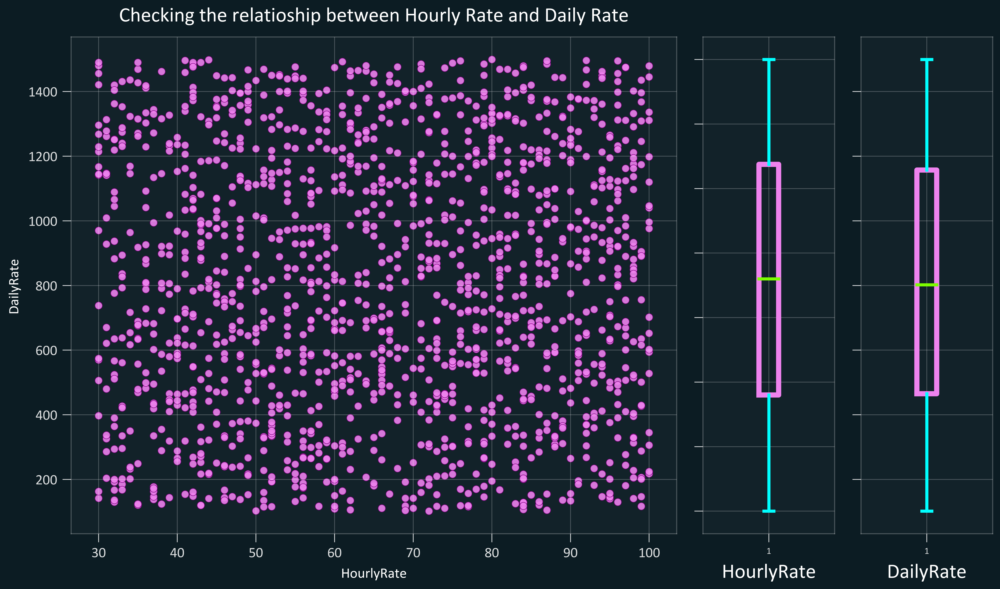

In [59]:
fig = plt.figure(figsize=(16, 10), dpi= 600)
grid = plt.GridSpec(8, 6, hspace=0.5, wspace=0.2)

ax_main = fig.add_subplot(grid[:-1, :-2])
ax_right = fig.add_subplot(grid[:-1, -2], xticklabels=[], yticklabels=[])
ax_left = fig.add_subplot(grid[:-1, -1], xticklabels=[], yticklabels=[])

ax_main.scatter('HourlyRate', 'DailyRate', alpha=.9, data=df, color="violet", edgecolors='purple', linewidths=.5,s=50)

ax_right.boxplot(df.HourlyRate,boxprops=boxprops2,flierprops=flierprops,
            medianprops=medianprops,capprops=capprops,whiskerprops=whiskerprops)

ax_left.boxplot(df.DailyRate,boxprops=boxprops2,flierprops=flierprops,
            medianprops=medianprops,capprops=capprops,whiskerprops=whiskerprops)

ax_left.set(xlabel='DailyRate')
ax_right.set(xlabel='HourlyRate')

ax_main.set(title='Checking the relatioship between Hourly Rate and Daily Rate', xlabel='HourlyRate', ylabel='DailyRate')

ax_main.title.set_fontsize(20)
for item in ([ax_main.xaxis.label, ax_main.yaxis.label] + ax_main.get_xticklabels() + ax_main.get_yticklabels()):
    item.set_fontsize(14)

plt.show()

Here also we can see that there is no concrete proof to show the relationship between the two variables.

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\597101563.py:30: UserWarning:

FixedFormatter should only be used together with FixedLocator



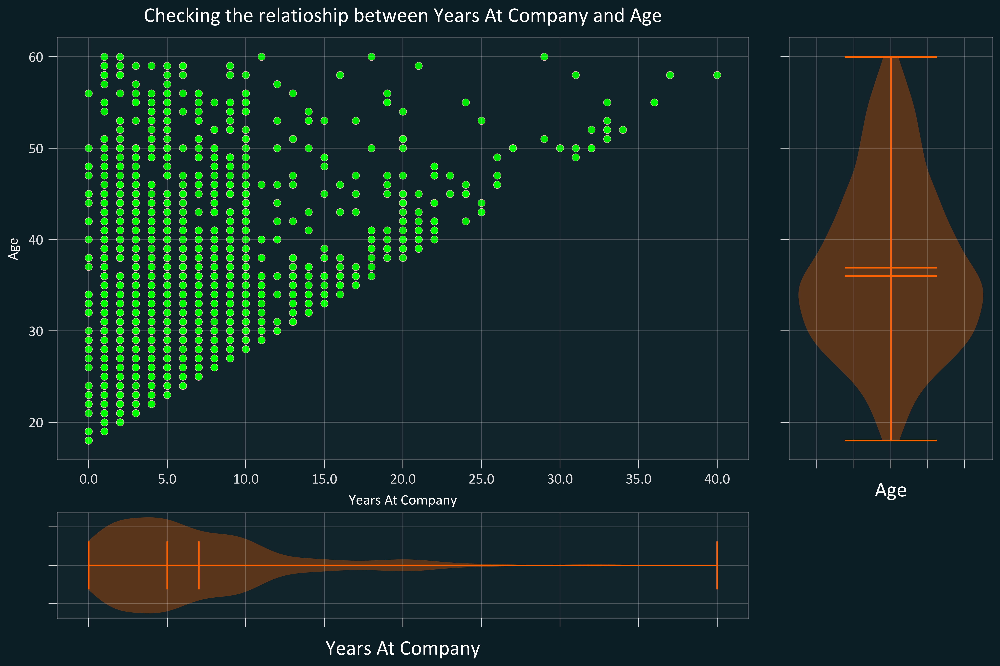

In [60]:
fig = plt.figure(figsize=(16, 10), dpi= 600)
grid = plt.GridSpec(4, 4, hspace=0.5, wspace=0.2)


ax_main = fig.add_subplot(grid[:-1, :-1])
ax_right = fig.add_subplot(grid[:-1, -1], xticklabels=[], yticklabels=[])
ax_bottom = fig.add_subplot(grid[-1, 0:-1], xticklabels=[], yticklabels=[])

ax_main.scatter('YearsAtCompany', 'Age', alpha=.9, data=df, color="lime", edgecolors='pink', linewidths=.4,s=50)


ax_bottom.violinplot(df.YearsAtCompany,positions=None, vert=False, widths=0.5,
           showmeans=True, showextrema=True, showmedians=True,
           quantiles=None, points=100, bw_method=None, data=None)
ax_bottom.invert_yaxis()


ax_right.violinplot(df.Age,positions=None, vert=True, widths=0.5,
           showmeans=True, showextrema=True, showmedians=True,
           quantiles=None, points=100, bw_method=None, data=None)

ax_right.set(xlabel='Age')
ax_bottom.set(xlabel='Years At Company')
ax_main.set(title='Checking the relatioship between Years At Company and Age', xlabel='Years At Company', ylabel='Age')
ax_main.title.set_fontsize(20)
for item in ([ax_main.xaxis.label, ax_main.yaxis.label] + ax_main.get_xticklabels() + ax_main.get_yticklabels()):
    item.set_fontsize(14)

xlabels = ax_main.get_xticks().tolist()
ax_main.set_xticklabels(xlabels)
plt.show()

here we can see that more aged people are on the lower side of the years at company which means that very less employees stay in the organization for more that 20 years.

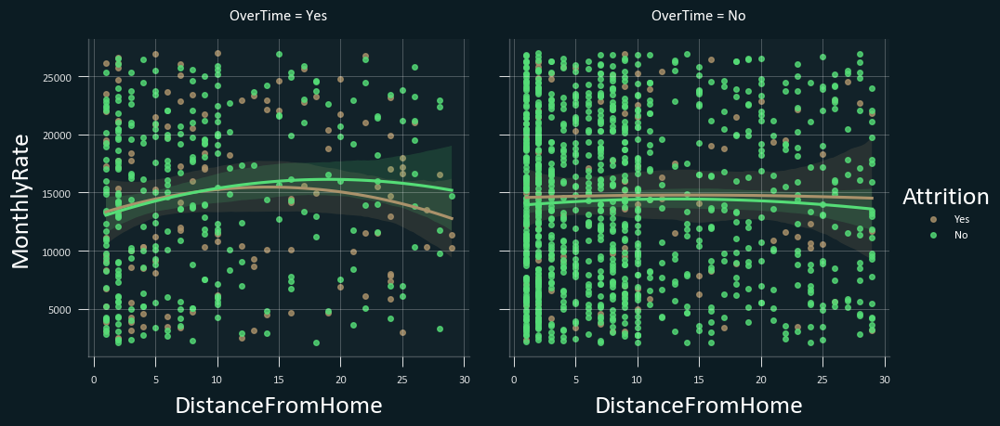

In [61]:
ax = sns.lmplot(x="DistanceFromHome" , y="MonthlyRate", data=df, col="OverTime", order= 2, hue="Attrition", palette="terrain_r")

##### The shaded area shows the prediction of Monthly Rates.
##### From the above plot we can see that the rates prediction range of income which are not doing overtime is much less spread out as compared to the people doing overtime.

![](https://media.tenor.com/zcs5gYi4sSMAAAAC/mindblown-omg.gif)

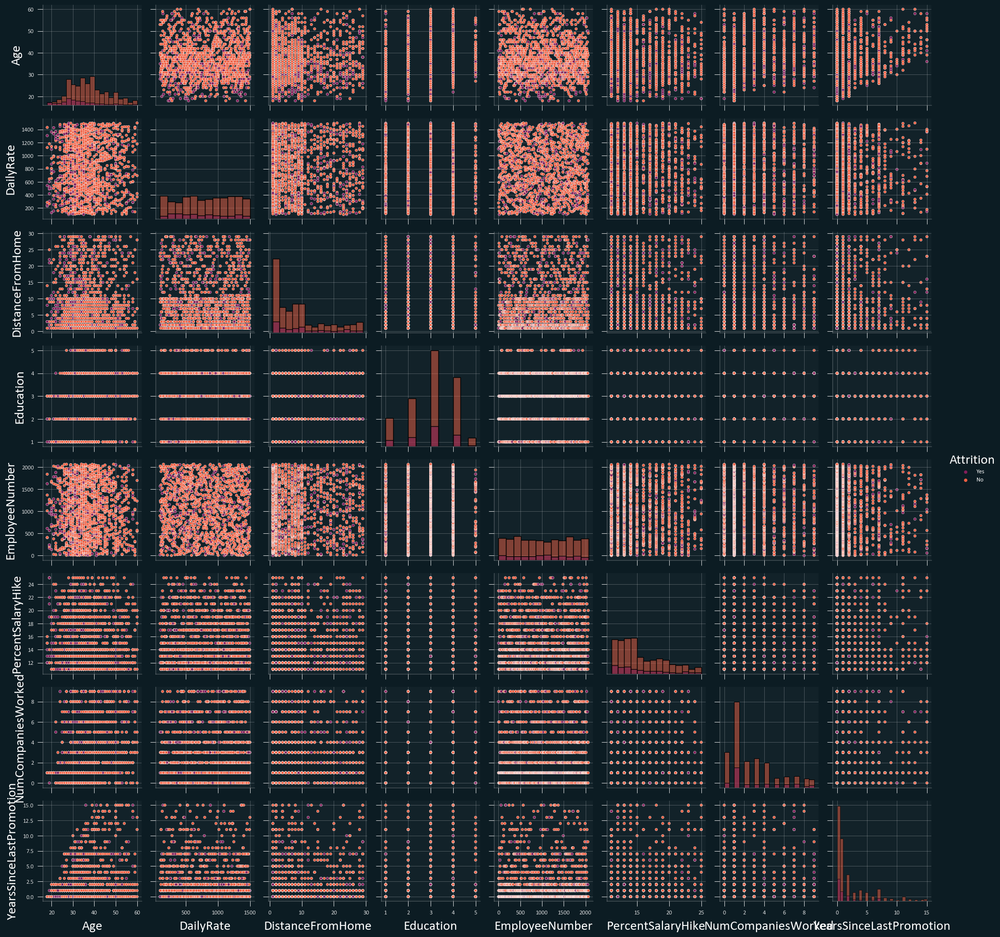

In [62]:
Df = ['Age', 'DailyRate', 'DistanceFromHome', 'Education', 'EmployeeNumber', 'PercentSalaryHike','NumCompaniesWorked','YearsSinceLastPromotion','Attrition'] 
sns.pairplot(df[Df],diag_kind="hist", hue="Attrition", palette="rocket")

Text(0.5, 1.0, ' Monthly Income by Marital Status')

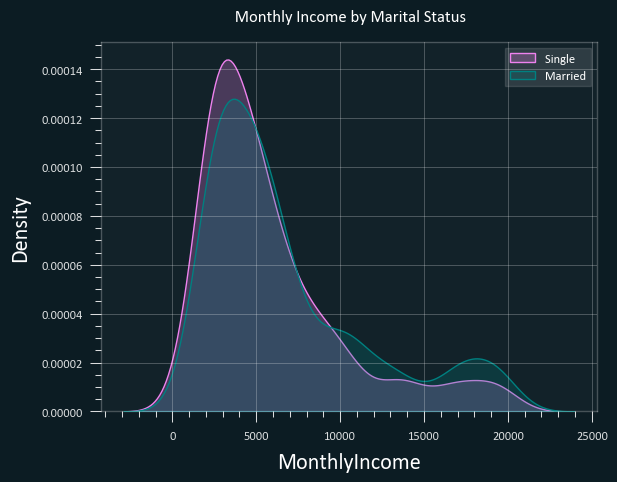

In [140]:

ax = sns.kdeplot(df['MonthlyIncome'][df['MaritalStatus']=='Single'],color="Violet" , fill = True)
ax = sns.kdeplot(df['MonthlyIncome'][df['MaritalStatus']=='Married'], color="teal", fill = True)
ax.legend(["Single ","Married"])
ax.set_title(' Monthly Income by Marital Status')

Single people are gitting more monthly income.

Text(0.5, 1.0, 'DailyRate by Gender')

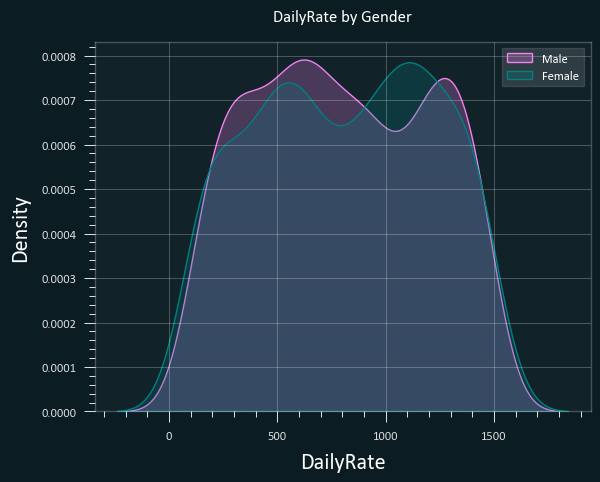

In [141]:

ax = sns.kdeplot(df['DailyRate'][df['Gender']=='Male'],color="Violet" , fill = True)
ax = sns.kdeplot(df['DailyRate'][df['Gender']=='Female'], color="teal", fill = True)
ax.legend(["Male","Female"])
ax.set_title('DailyRate by Gender')

Males and Females are relatively having the same hDailyrates which means there is no gender discrimination in the organization.

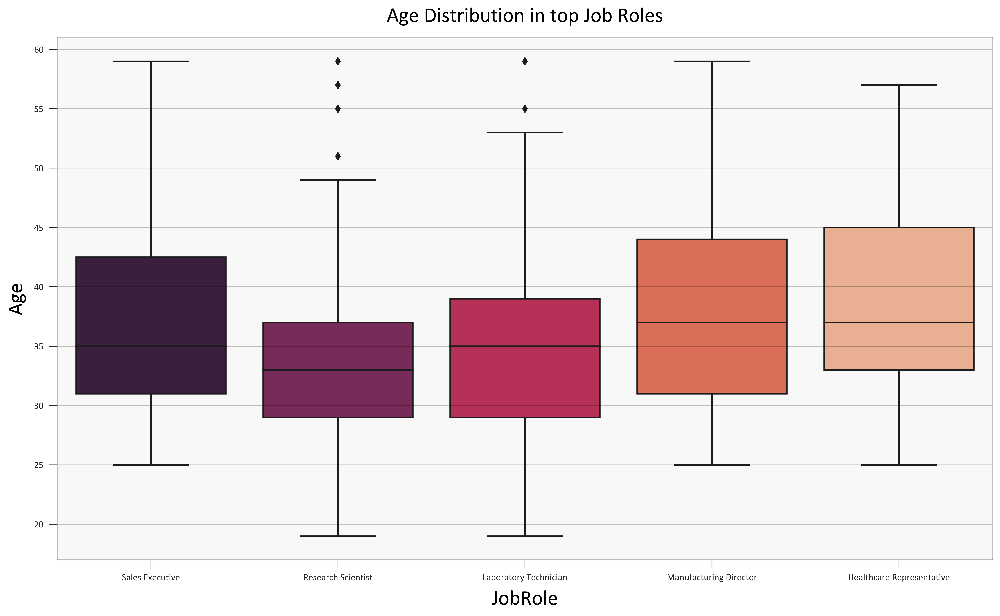

In [87]:
plt.figure(figsize=(16,9), dpi=600)
top_roles = df['JobRole'].value_counts().head(5)
top_roles_name = top_roles.index
df_roles_age = df.loc[df['JobRole'].isin(top_roles_name)& df['Age']]
plt.figure(1 , figsize = (12,6))
sns.boxplot(x = 'JobRole' , y = 'Age' , data = df_roles_age, palette='rocket')
plt.title('Age Distribution in top Job Roles', fontsize=20)
plt.xticks(rotation = 0)
plt.show()

We can see that most of the old peoplo are in Healthcare role but there are outliers aged around60 in the Laboratory Technician and the Research Scientis job roles.

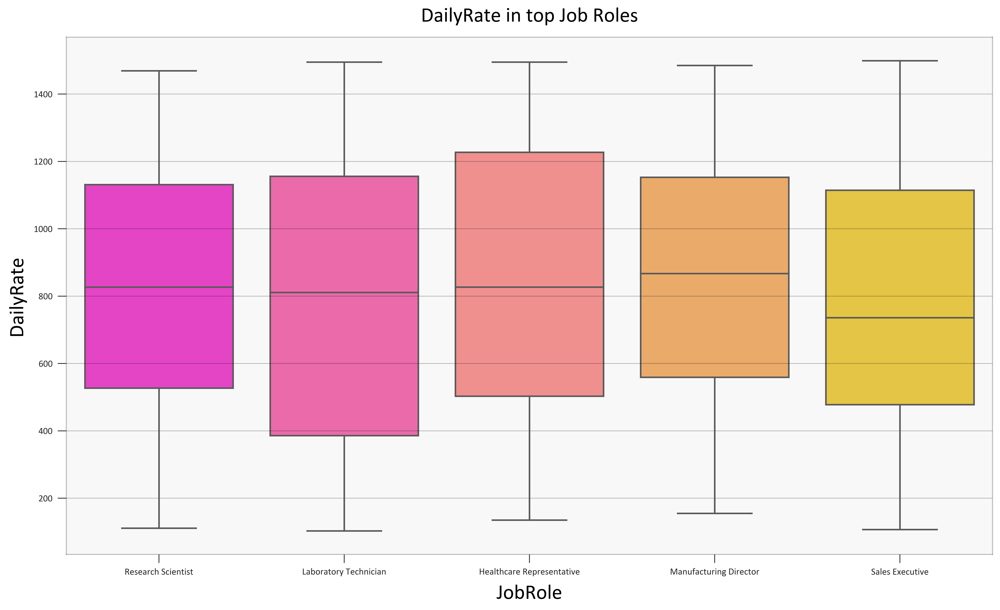

In [89]:
plt.figure(figsize=(16,9), dpi=600)
top_roles = df['JobRole'].value_counts().head(5)
top_roles_name = top_roles.index
df_roles_age = df.loc[df['JobRole'].isin(top_roles_name)& df['DailyRate']]
plt.figure(1 , figsize = (12,6))
sns.boxplot(x = 'JobRole' , y = 'DailyRate' , data = df_roles_age, palette='spring')
plt.title('DailyRate in top Job Roles', fontsize=20)
plt.xticks(rotation = 0)
plt.show()

Above are the top 5 most paying daily rate job roles with Healthcare Representative on the top followed by laboratory technician.

Text(0.5, 1.0, 'Education Field wise Monthly Income')

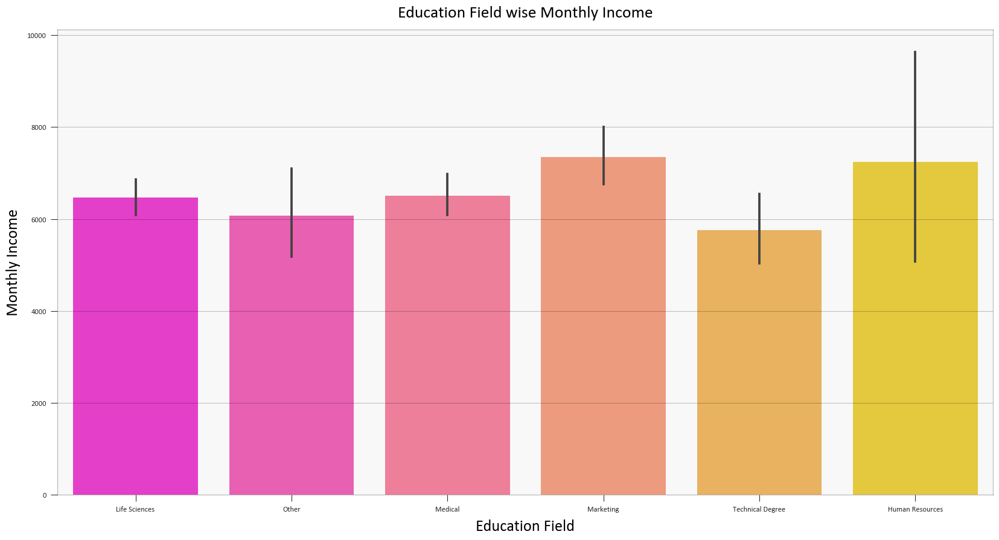

In [90]:
plt.figure(figsize = (20,10))
ax = sns.barplot(x = 'EducationField' , y = 'MonthlyIncome' , data = df, palette='spring')
ax.set_xlabel(xlabel = 'Education Field', fontsize = 19)
ax.set_ylabel(ylabel = 'Monthly Income', fontsize = 19)
plt.title('Education Field wise Monthly Income', fontsize = 20)

Above is the plot showing the most paying education field. We can see that marketing is the most paying education field followed by Human resource 

Text(0.5, 1.0, 'Education Field wise Monthly Income')

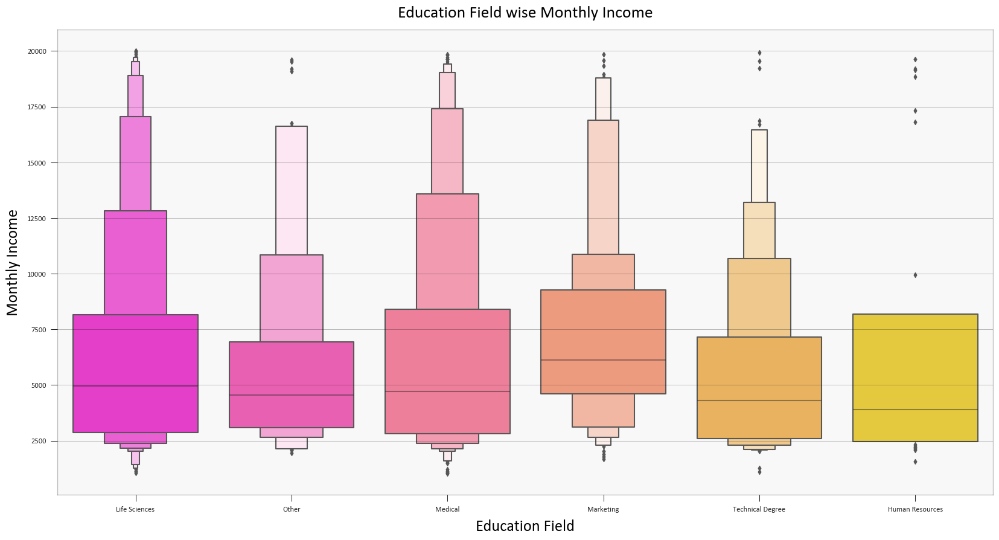

In [91]:
plt.figure(figsize = (20,10))
ax = sns.boxenplot(x = 'EducationField' , y = 'MonthlyIncome' , data = df, palette='spring')
ax.set_xlabel(xlabel = 'Education Field', fontsize = 19)
ax.set_ylabel(ylabel = 'Monthly Income', fontsize = 19)
plt.title('Education Field wise Monthly Income', fontsize = 20)

A boxen plot for the above bar plot to get more insight on the density on each interval

Text(0.5, 1.0, 'Education Field wise Age')

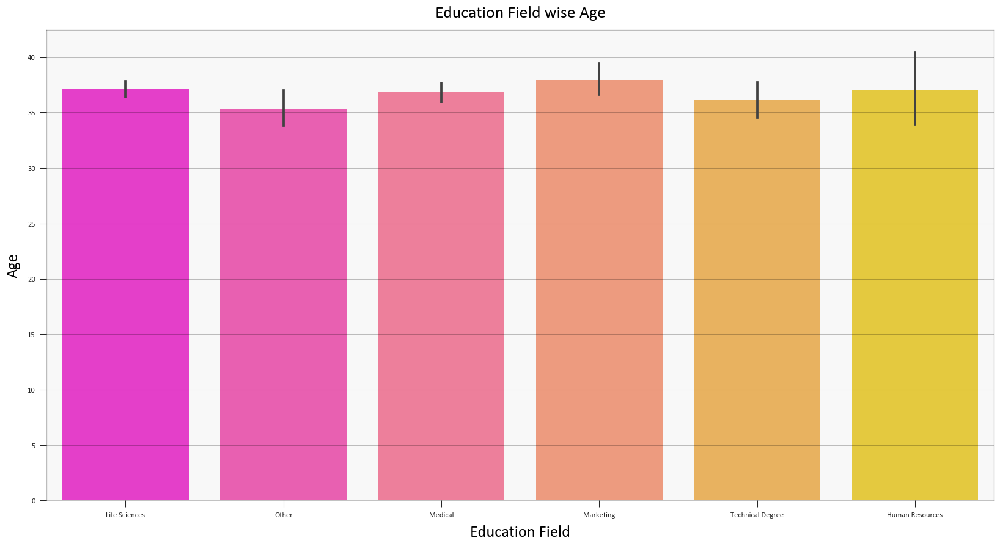

In [92]:
plt.figure(figsize = (20,10))
ax = sns.barplot(x = 'EducationField' , y = 'Age' , data = df, palette='spring')
ax.set_xlabel(xlabel = 'Education Field', fontsize = 19)
ax.set_ylabel(ylabel = 'Age', fontsize = 19)
plt.title('Education Field wise Age', fontsize = 20)

Above plot is showing the age wise education field distribution in the organization, we can see that most aged people are from marketing education field department only

Text(0.5, 1.0, 'Education Field wise Age')

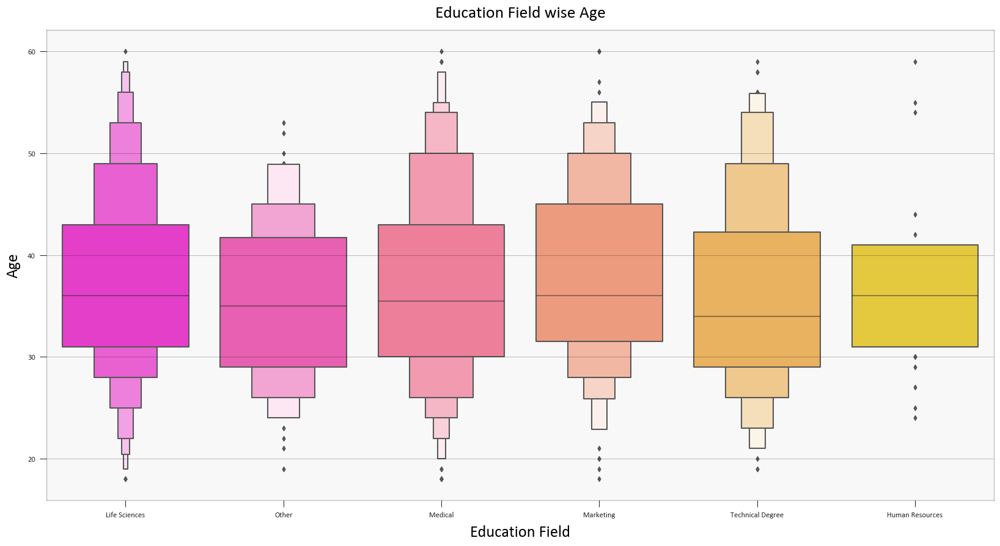

In [93]:
plt.figure(figsize = (20,10))
ax = sns.boxenplot(x = 'EducationField' , y = 'Age' , data = df, palette='spring')
ax.set_xlabel(xlabel = 'Education Field', fontsize = 19)
ax.set_ylabel(ylabel = 'Age', fontsize = 19)
plt.title('Education Field wise Age', fontsize = 20)

A boxen plot for the above bar plot to get more insight on the density on each interval

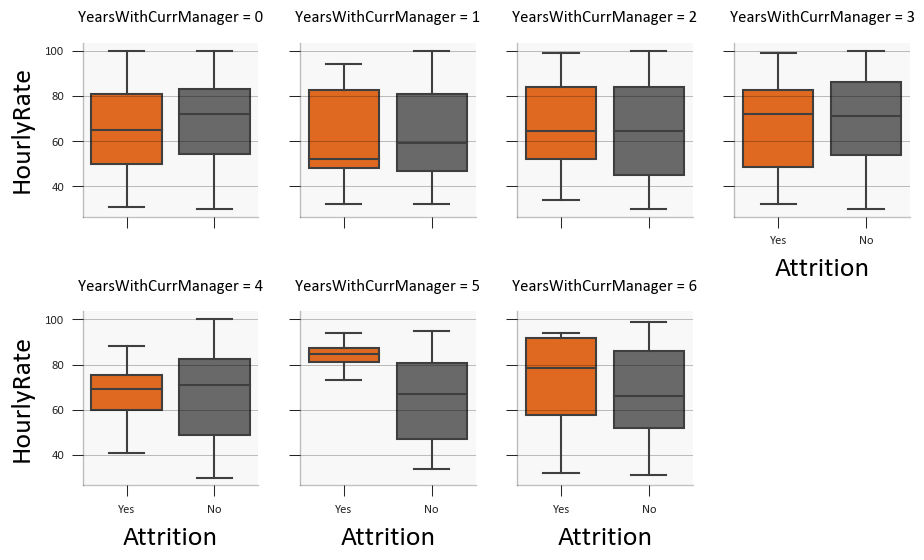

In [94]:
sns.catplot(x="Attrition", y="HourlyRate", col="YearsWithCurrManager", data=df[df["YearsWithCurrManager"] < 7],kind="box",col_wrap=4,height=3,aspect=0.8);

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\2455183122.py:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



<Axes: >

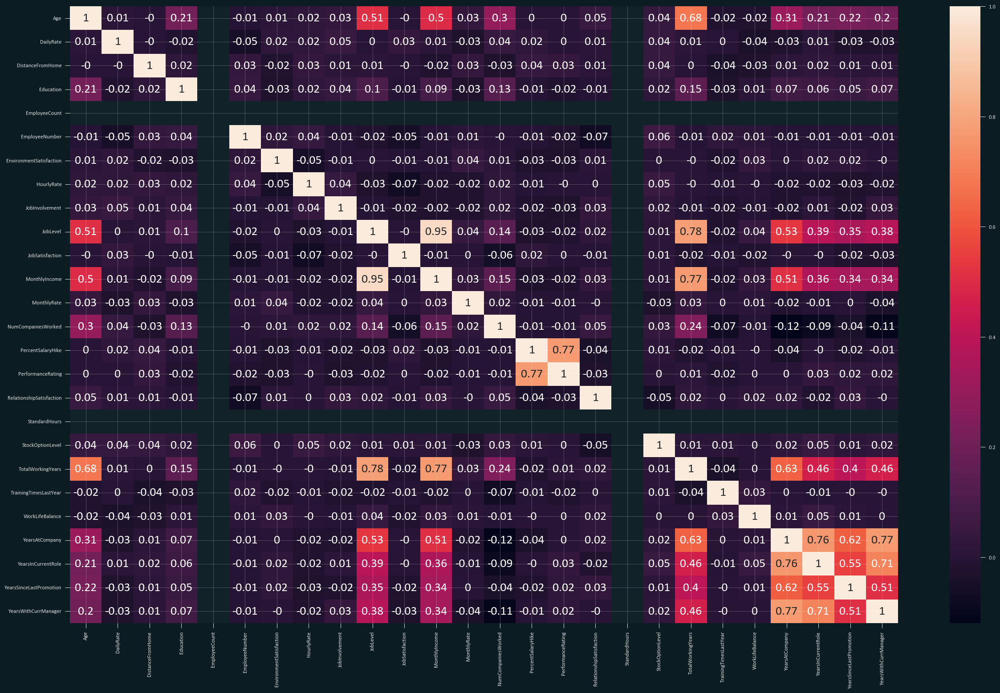

In [72]:
plt.figure(figsize = (30, 18))
sns.heatmap(np.round(df.corr(),2),annot=True)

In the above correlation plot we can see each variables relationship with each other.
- We can see that monthly income is highly co related to Joblevel and total working hours.
- We can also see that monthly income is negatively correlated to distance from home, job involvement etc.

### A barplot showing the correlation

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\451937321.py:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



<Axes: >

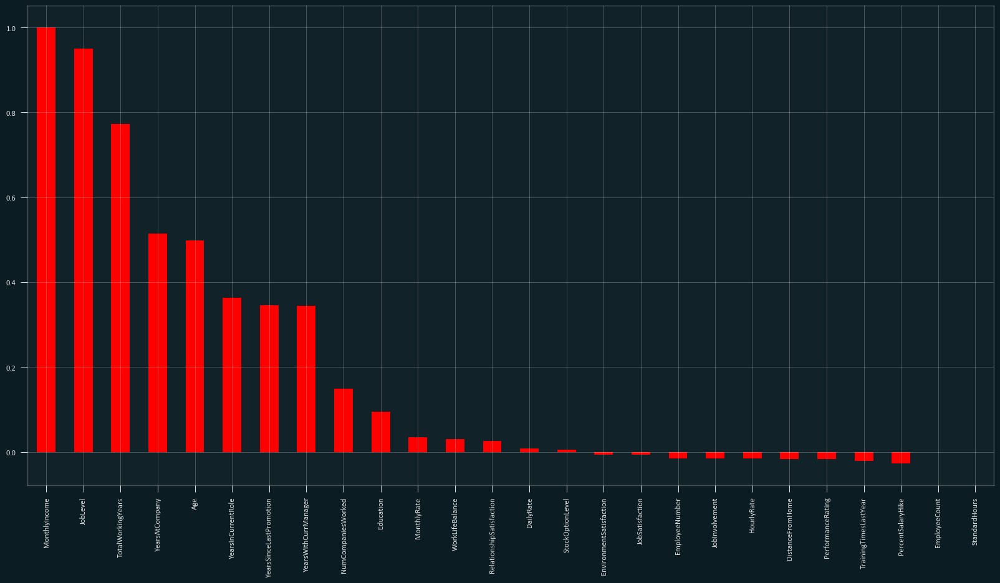

In [73]:
plt.figure(figsize=(20,10))
df.corr()['MonthlyIncome'].sort_values(ascending = False).plot(kind='bar',color="red")

In [74]:
positiv_corrs = df.corr()['MonthlyIncome'][df.corr()['MonthlyIncome'] > 0]

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\4206076051.py:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



### Plotting a heatmap to show all the varibles having a positive correlation.

<Axes: >

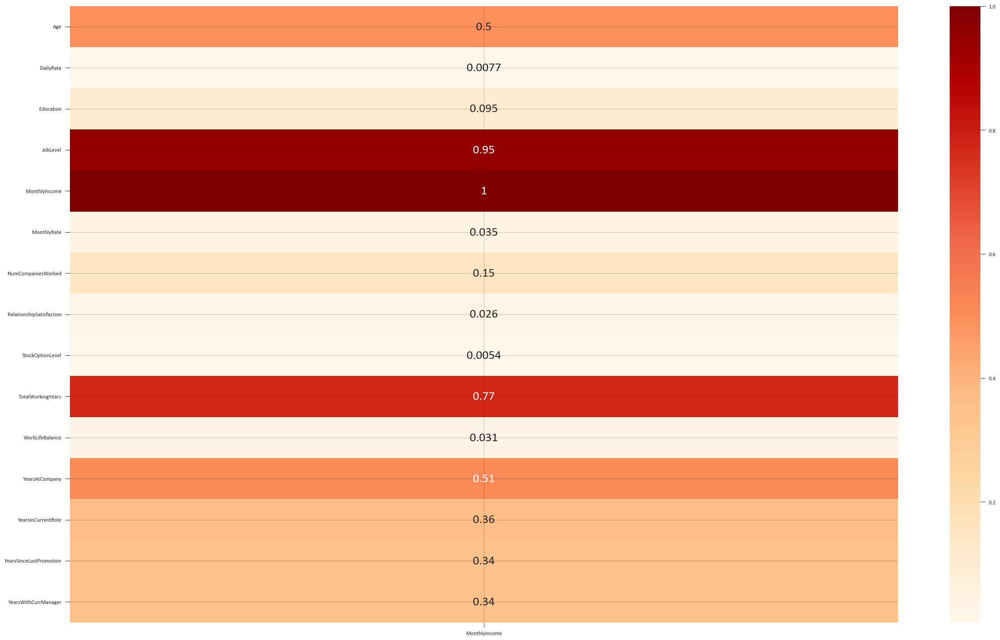

In [95]:
plt.figure(figsize = (30,18))
sns.heatmap(data=pd.DataFrame(positiv_corrs), annot=True,cmap = 'OrRd')

In [76]:
negative_corrs = df.corr()['MonthlyIncome'][df.corr()['MonthlyIncome'] < 0]

C:\Users\daksh\AppData\Local\Temp\ipykernel_17244\3222470518.py:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



### Plotting a heatmap to show all the varibles having a negative correlation.

<Axes: >

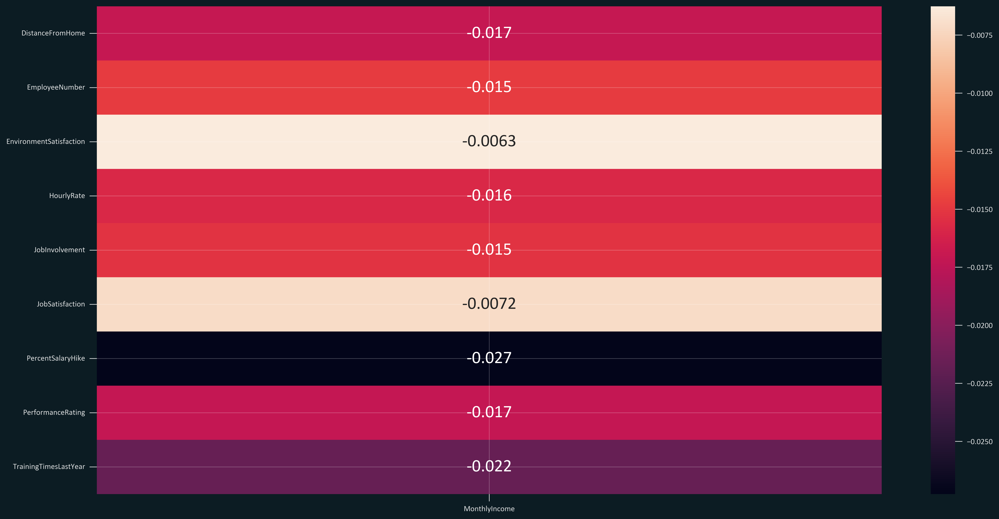

In [77]:
plt.figure(figsize = (20,10), dpi=600)
sns.heatmap(data=pd.DataFrame(negative_corrs), annot=True)

# WordCloud

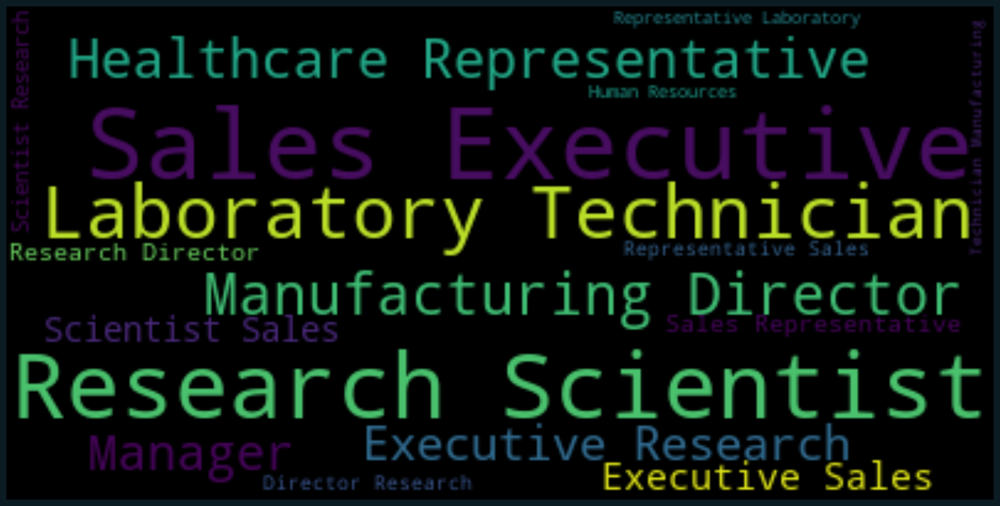

In [79]:
text = " ".join(n for n in df['JobRole'])
wc =  WordCloud(background_color='black').generate(text)
plt.figure(figsize=(20,10))
plt.imshow(wc, interpolation='bilinear')
plt.axis('off')
plt.show()

# Modelling

In [142]:
df_c = df['Attrition']

In [143]:
df = df.drop('Attrition',axis=1)

In [144]:
df.head(1)

,Age,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,2,...,1,80,0,8,0,1,6,4,0,5


## Time to seperate our numerical and categorical columns

In [145]:
df.select_dtypes(include=['object'])

,BusinessTravel,Department,EducationField,Gender,JobRole,MaritalStatus,Over18,OverTime
0,Travel_Rarely,Sales,Life Sciences,Female,Sales Executive,Single,Y,Yes
1,Travel_Frequently,Research & Development,Life Sciences,Male,Research Scientist,Married,Y,No
2,Travel_Rarely,Research & Development,Other,Male,Laboratory Technician,Single,Y,Yes
3,Travel_Frequently,Research & Development,Life Sciences,Female,Research Scientist,Married,Y,Yes
4,Travel_Rarely,Research & Development,Medical,Male,Laboratory Technician,Married,Y,No
...,...,...,...,...,...,...,...,...
1465,Travel_Frequently,Research & Development,Medical,Male,Laboratory Technician,Married,Y,No
1466,Travel_Rarely,Research & Development,Medical,Male,Healthcare Representative,Married,Y,No
1467,Travel_Rarely,Research & Development,Life Sciences,Male,Manufacturing Director,Married,Y,Yes
1468,Travel_Frequently,Sales,Medical,Male,Sales Executive,Married,Y,No


In [146]:
df_cat = df.select_dtypes(include=['object'])

In [147]:
df.select_dtypes(exclude = "object")

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1102,1,2,1,1,2,94,3,2,...,1,80,0,8,0,1,6,4,0,5
1,49,279,8,1,1,2,3,61,2,2,...,4,80,1,10,3,3,10,7,1,7
2,37,1373,2,2,1,4,4,92,2,1,...,2,80,0,7,3,3,0,0,0,0
3,33,1392,3,4,1,5,4,56,3,1,...,3,80,0,8,3,3,8,7,3,0
4,27,591,2,1,1,7,1,40,3,1,...,4,80,1,6,3,3,2,2,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,36,884,23,2,1,2061,3,41,4,2,...,3,80,1,17,3,3,5,2,0,3
1466,39,613,6,1,1,2062,4,42,2,3,...,1,80,1,9,5,3,7,7,1,7
1467,27,155,4,3,1,2064,2,87,4,2,...,2,80,1,6,0,3,6,2,0,3
1468,49,1023,2,3,1,2065,4,63,2,2,...,4,80,0,17,3,2,9,6,0,8


In [148]:
df_numerical = df.select_dtypes(exclude = "object")

## One Hot Encoding

In [149]:
from sklearn.preprocessing import OneHotEncoder
enc = OneHotEncoder()

In [150]:
enc.fit(df_cat)

OneHotEncoder()

In [151]:
enc.transform(df_cat)

<1470x29 sparse matrix of type '<class 'numpy.float64'>'
	with 11760 stored elements in Compressed Sparse Row format>

In [152]:
enc.transform(df_cat).toarray()

array([[0., 0., 1., ..., 1., 0., 1.],
       [0., 1., 0., ..., 1., 1., 0.],
       [0., 0., 1., ..., 1., 0., 1.],
       ...,
       [0., 0., 1., ..., 1., 0., 1.],
       [0., 1., 0., ..., 1., 1., 0.],
       [0., 0., 1., ..., 1., 1., 0.]])

In [153]:
enc.get_feature_names_out()

array(['BusinessTravel_Non-Travel', 'BusinessTravel_Travel_Frequently',
       'BusinessTravel_Travel_Rarely', 'Department_Human Resources',
       'Department_Research & Development', 'Department_Sales',
       'EducationField_Human Resources', 'EducationField_Life Sciences',
       'EducationField_Marketing', 'EducationField_Medical',
       'EducationField_Other', 'EducationField_Technical Degree',
       'Gender_Female', 'Gender_Male',
       'JobRole_Healthcare Representative', 'JobRole_Human Resources',
       'JobRole_Laboratory Technician', 'JobRole_Manager',
       'JobRole_Manufacturing Director', 'JobRole_Research Director',
       'JobRole_Research Scientist', 'JobRole_Sales Executive',
       'JobRole_Sales Representative', 'MaritalStatus_Divorced',
       'MaritalStatus_Married', 'MaritalStatus_Single', 'Over18_Y',
       'OverTime_No', 'OverTime_Yes'], dtype=object)

In [154]:
pd.DataFrame(enc.transform(df_cat).toarray(), columns = enc.get_feature_names_out())

,BusinessTravel_Non-Travel,BusinessTravel_Travel_Frequently,BusinessTravel_Travel_Rarely,Department_Human Resources,Department_Research & Development,Department_Sales,EducationField_Human Resources,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,...,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Over18_Y,OverTime_No,OverTime_Yes
0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0
1,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0
2,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0
3,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0
4,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0
1466,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0
1467,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0
1468,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0


In [155]:
df2 = pd.DataFrame(enc.transform(df_cat).toarray(), columns = enc.get_feature_names_out())

In [156]:
df2.head(1)

,BusinessTravel_Non-Travel,BusinessTravel_Travel_Frequently,BusinessTravel_Travel_Rarely,Department_Human Resources,Department_Research & Development,Department_Sales,EducationField_Human Resources,EducationField_Life Sciences,EducationField_Marketing,EducationField_Medical,...,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Over18_Y,OverTime_No,OverTime_Yes
0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0


In [157]:
from joblib import dump, load
dump(enc, 'encoder.joblib')

['encoder.joblib']

In [158]:
df3 = df_numerical.join(df2)

In [159]:
df3.head(1)

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Over18_Y,OverTime_No,OverTime_Yes
0,41,1102,1,2,1,1,2,94,3,2,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0


In [160]:
# Checking for any null values
df3.isnull().sum()

Age                                  0
DailyRate                            0
DistanceFromHome                     0
Education                            0
EmployeeCount                        0
EmployeeNumber                       0
EnvironmentSatisfaction              0
HourlyRate                           0
JobInvolvement                       0
JobLevel                             0
JobSatisfaction                      0
MonthlyIncome                        0
MonthlyRate                          0
NumCompaniesWorked                   0
PercentSalaryHike                    0
PerformanceRating                    0
RelationshipSatisfaction             0
StandardHours                        0
StockOptionLevel                     0
TotalWorkingYears                    0
TrainingTimesLastYear                0
WorkLifeBalance                      0
YearsAtCompany                       0
YearsInCurrentRole                   0
YearsSinceLastPromotion              0
YearsWithCurrManager     

In [161]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()

In [162]:
# Fit your label encoder
le.fit(df_c)

LabelEncoder()

In [163]:
# Transform with your label encoder
df_c= y = le.transform(df_c)

In [164]:
df_c

array([1, 0, 1, ..., 0, 0, 0])

## Saving my label encoder

In [165]:
dump(le, 'le_encoder.joblib')

['le_encoder.joblib']

## Let's split our data

In [166]:
X_train, X_test, y_train, y_test = train_test_split(df3, df_c, test_size=0.4, random_state=42)

In [167]:
X_train.head(1)

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,JobRole_Research Director,JobRole_Research Scientist,JobRole_Sales Executive,JobRole_Sales Representative,MaritalStatus_Divorced,MaritalStatus_Married,MaritalStatus_Single,Over18_Y,OverTime_No,OverTime_Yes
442,36,635,10,4,1,592,2,32,3,3,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0


In [168]:
y_train

array([0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1,
       0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1,
       0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,

## Modelling Begins

In [169]:
clf = DecisionTreeClassifier(min_samples_split=100, max_depth=20)

In [170]:
clf = clf.fit(X_train, y_train)

In [171]:
clf.score(X_train,y_train)

0.8480725623582767

In [172]:
from sklearn import tree

[Text(0.5384615384615384, 0.9642857142857143, 'x[54] <= 0.5\ngini = 0.291\nsamples = 882\nvalue = [726, 156]'),
 Text(0.3076923076923077, 0.8928571428571429, 'x[19] <= 2.5\ngini = 0.196\nsamples = 625\nvalue = [556, 69]'),
 Text(0.23076923076923078, 0.8214285714285714, 'gini = 0.437\nsamples = 62\nvalue = [42, 20]'),
 Text(0.38461538461538464, 0.8214285714285714, 'x[25] <= 1.5\ngini = 0.159\nsamples = 563\nvalue = [514, 49]'),
 Text(0.3076923076923077, 0.75, 'gini = 0.29\nsamples = 91\nvalue = [75, 16]'),
 Text(0.46153846153846156, 0.75, 'x[1] <= 1495.5\ngini = 0.13\nsamples = 472\nvalue = [439, 33]'),
 Text(0.38461538461538464, 0.6785714285714286, 'x[22] <= 31.5\ngini = 0.127\nsamples = 471\nvalue = [439, 32]'),
 Text(0.3076923076923077, 0.6071428571428571, 'x[1] <= 1357.5\ngini = 0.12\nsamples = 467\nvalue = [437, 30]'),
 Text(0.23076923076923078, 0.5357142857142857, 'x[19] <= 14.5\ngini = 0.097\nsamples = 413\nvalue = [392, 21]'),
 Text(0.15384615384615385, 0.4642857142857143, 'x[1]

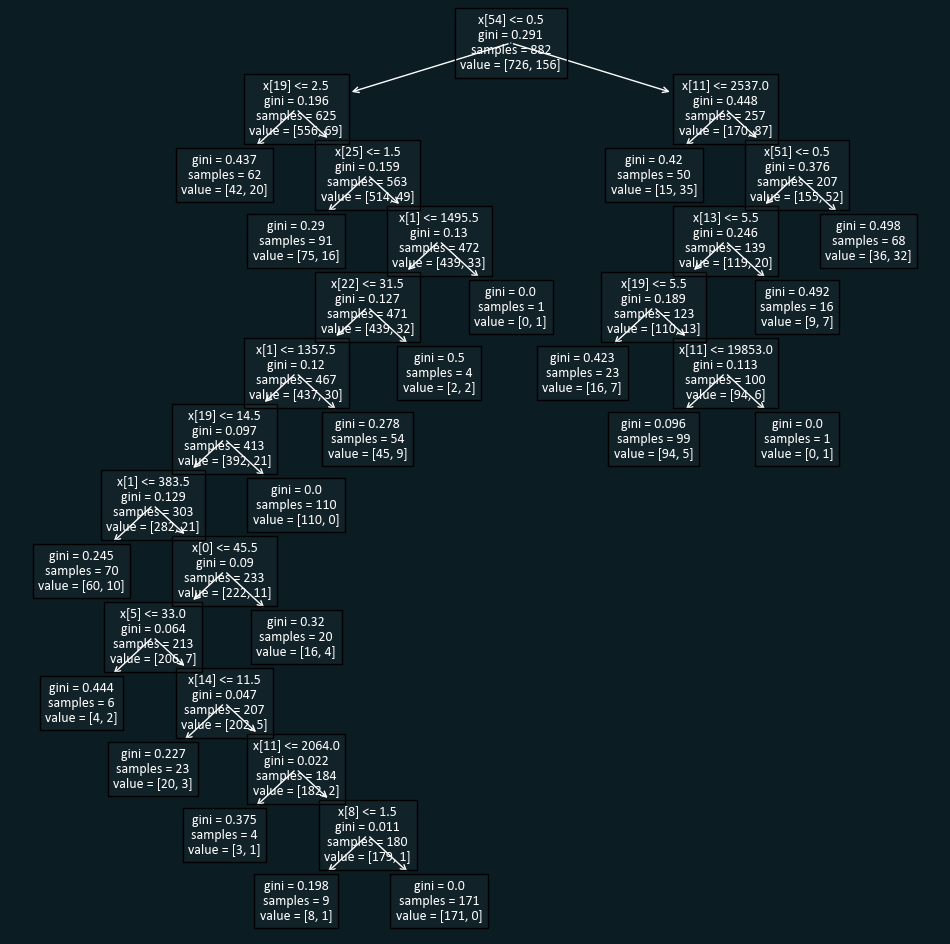

In [173]:
plt.figure(figsize=(12,12))
tree.plot_tree(clf, fontsize=10)

### Checking the Train accracy of our model to compare it with the Test accuracy to see how well is our model predicts

In [174]:
from sklearn.metrics import accuracy_score

In [175]:
clf.predict(X_train)

array([0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [176]:
y_pred_train_clf = clf.predict(X_train)

In [177]:
acc = accuracy_score(y_train,y_pred_train_clf)

In [178]:
acc

0.8480725623582767

In [179]:
le.inverse_transform(clf.predict(X_train.head(1)))

array(['No'], dtype=object)

In [180]:
le.inverse_transform([0])

array(['No'], dtype=object)

# 84% Accuracy!!!

# Plotting a Confusion Matrix

In [181]:
cm = confusion_matrix(y_train,y_pred_train_clf)

Text(0.5, 1.0, 'Prediction')

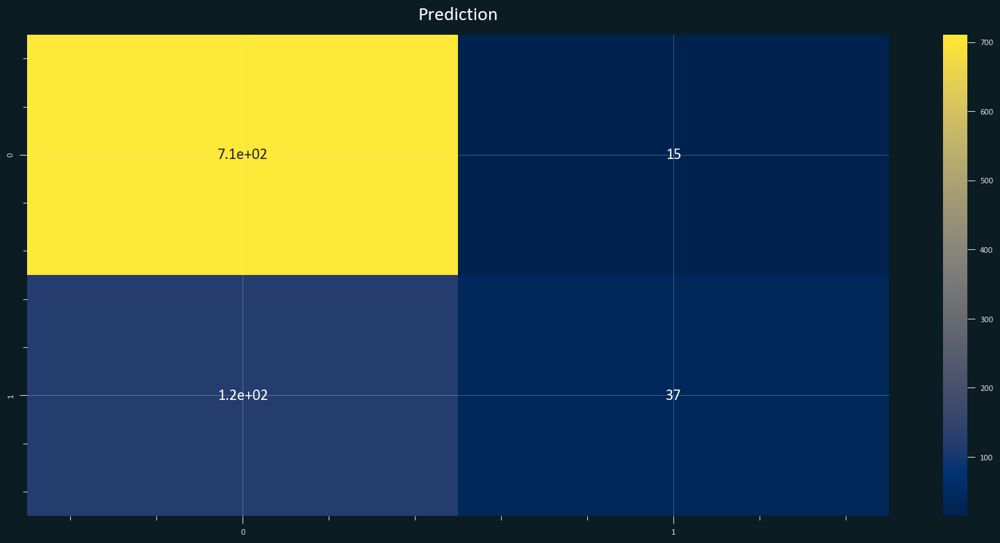

In [182]:
plt.figure(figsize = (20,9))
sns.heatmap(cm, annot=True, cmap="cividis")
plt.title('Prediction', fontsize=20)

### Checking our model accuracy on the Testing data to see if our model is reliable or not

In [183]:
y_pred_test_clf = clf.predict(X_test)

In [184]:
acc = accuracy_score(y_test,y_pred_test_clf)

![](https://media.tenor.com/HWU9s_mEieEAAAAM/bh187-spongebob.gif)

In [185]:
acc

0.8690476190476191

# 86% Here Lesss goooo!!!

# Plotting a Confusion Matrix for the Testing Predictions

In [186]:
cm1 = confusion_matrix(y_test,y_pred_test_clf)

Text(0.5, 1.0, 'Prediction')

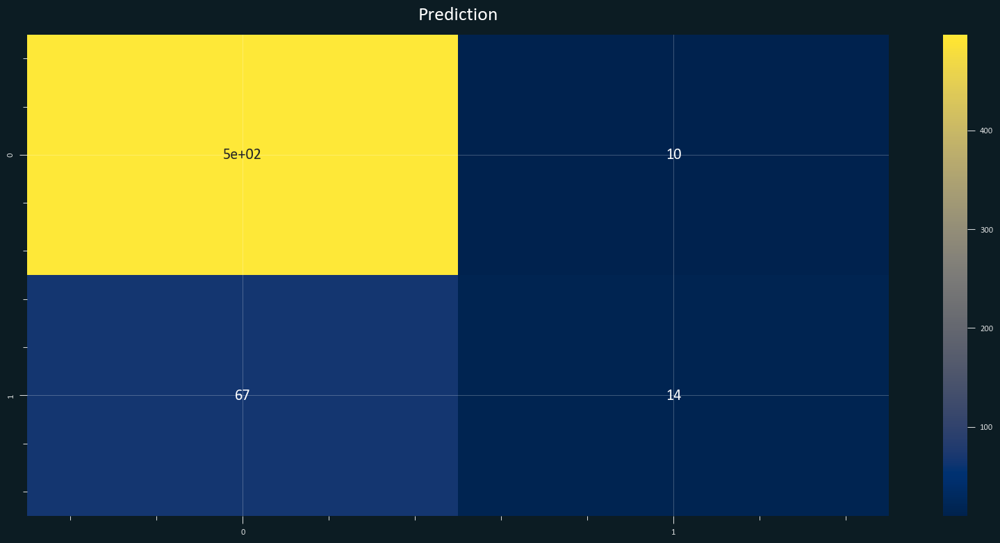

In [187]:
plt.figure(figsize = (20,9))
sns.heatmap(cm1, annot=True, cmap="cividis")
plt.title('Prediction', fontsize=20)

## Wrapping all of it in a function

In [188]:
# Saving my Decision tree model
from joblib import dump, load
dump(clf, 'decision_tree.joblib')

['decision_tree.joblib']

In [189]:
def function(model_path, encoder_path,le_encoder_path, user_input):
    # Loading our decision tree model
    clf = load(model_path)
    print ('1')
    # Loading our encoder
    enc = load(encoder_path)
    print ('2')
    # Let's load my label encoder
    le = load(le_encoder_path)
    print ('3')
    pd_columns = ['Age', 'BusinessTravel', 'DailyRate', 'Department', 'DistanceFromHome', 'Education', 'EducationField', 'EmployeeCount', 'EmployeeNumber', 'EnvironmentSatisfaction', 'Gender', 'HourlyRate', 'JobInvolvement', 'JobLevel', 'JobRole', 'JobSatisfaction', 'MaritalStatus', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked', 'Over18', 'OverTime', 'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion','YearsWithCurrManager']
    print ('4')
    myDict = {k:[v] for k,v in zip(pd_columns, user_input)}
    print ('5')
    # Creating DataFrame
    df_temp = pd.DataFrame(myDict)
    print ('6')
    # Get your categorical dataframe
    cat_data = df_temp[['BusinessTravel', 'Department', 'EducationField','Gender','JobRole','MaritalStatus','Over18','OverTime']]
    print ('7')
    # Get your numerical dataframe
    num_data = df_temp[['Age', 'DailyRate','DistanceFromHome','Education','EmployeeCount','EmployeeNumber','EnvironmentSatisfaction','HourlyRate','JobInvolvement','JobLevel','JobSatisfaction','MonthlyIncome','MonthlyRate','NumCompaniesWorked','PercentSalaryHike','PerformanceRating','RelationshipSatisfaction','StandardHours','StockOptionLevel','TotalWorkingYears','TrainingTimesLastYear','WorkLifeBalance','YearsAtCompany','YearsInCurrentRole','YearsSinceLastPromotion','YearsWithCurrManager']]
    print ('8')
    # Encode your categorical columns
    enc.transform(cat_data)
    print ('9')
    enc.transform(cat_data).toarray()
    print ('10')
    # Let's create a DataFrame now
    pd.DataFrame(enc.transform(cat_data).toarray(), columns = enc.get_feature_names_out())
    print ('11')
    # Save your encoded df.
    df_encoded = pd.DataFrame(enc.transform(cat_data).toarray(), columns = enc.get_feature_names_out())
    print ('12')
    # Combine your encoded df with your df_num
    df_Final = num_data.join(df_encoded)
    print ('13')
    # Predict
    clf.predict(df_Final)
    print ('14')
    # Saving out prediction
    prediction = clf.predict(df_Final)
    print ('15')
    le.inverse_transform(prediction)
    print ('16')
    output = le.inverse_transform(prediction)[0]
    print ('The result is')
    return output

In [190]:
# Let's see
function('decision_tree.joblib', 'encoder.joblib', 'le_encoder.joblib', [41,'Travel_Rarely',1102,'Sales',1,2,'Life Sciences',1,1,2,'Female',94,3,2,'Sales Executive',4,'Single',5993,19479,8,'Y','Yes',11,3,1,80,0,8,0,1,6,4,0,5])

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
The result is


'No'

# The End.......I can finally rest and watch the sunrise of a grateful universe
![](https://media.tenor.com/xHY18avbYVcAAAAC/smiling-mcu.gif)